<a href="https://colab.research.google.com/github/BarNahmias/stars_tracker/blob/main/Start_tracker.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **star tracker**

is an algorithem that identify
stars in order to navigation in space

**Problem Description:**

Finding a match between two images with different size, orientation and lighting.
 
**General solution idea:**

The basic approach is very intuitive: when humans try to track stars, they look at the arrangement of stars - that is, they look for a pattern of constellations - instead of individual stars.



reference:

https://benedikt-bitterli.me/astro/





**Algorithm description:**

An algorithm for solving the problem of matching the stars between two images and finding the transition matrix between them

**Step A:** Image processing, noise filtering and finding the **coordinates** of the constellation in the two images

**Step B:** Finding a group **T1**,**T2** triangles whose vertices are the stars for each image.

**Step C:**
Finding the group of **similar triangles** from **T1**,**T2** according to sides.

**Step D:** Performing a **linear transformation** between two similar triangles **t1**,**t2**, in 6 points
and finding the common stars

**Step E:**  **Repeat** step **D** until finding the **best** transformation

In [3]:
from google.colab import drive
drive.mount('/content/drive' , force_remount=True)


#enter your foldername assignments/assignement1
FOLDERNAME = 'Vision'
              
assert FOLDERNAME is not None , "[!] Enter the foldername"

import sys
sys.path.append('/content/drive/My Drive/{}'.format(FOLDERNAME))
     

Mounted at /content/drive


**Extracting coordinates of stars from an image**

In [10]:
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow
import random


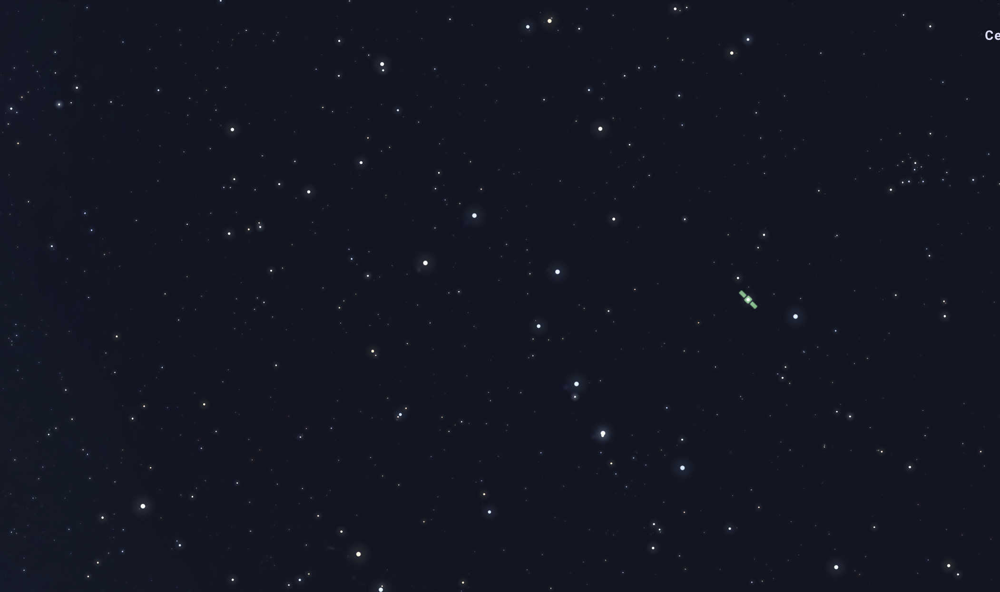

**Step A:** Image processing, noise filtering and finding the **coordinates** of the constellation in the two images

Star 1: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 2: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 3: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 4: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 5: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 6: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 7: X: 45 Y: 204 Radius: 0 Brightness: 0
Star 8: X: 45 Y: 204 Radius: 0 Brightness: 0
Star 9: X: 45 Y: 204 Radius: 0 Brightness: 0
Star 10: X: 102 Y: 914 Radius: 1 Brightness: 0
Star 11: X: 102 Y: 914 Radius: 1 Brightness: 0
Star 12: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 13: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 14: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 15: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 16: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 17: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 18: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 19: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 20: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 21: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 22: X: 138 Y: 820 Radius: 

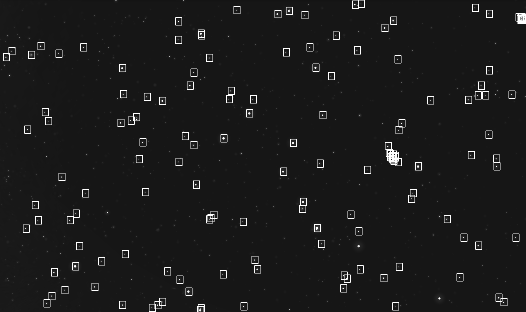

In [4]:
import cv2
import os
from google.colab.patches import cv2_imshow
"""
The function receives an image and performs noise filtering and image processing
"""
def process_image(image):
    # Load image
        img = cv2.imread(image, cv2.IMREAD_GRAYSCALE)

        # Create SIFT object
        sift = cv2.SIFT_create()

        # Detect keypoints and descriptors using SIFT
        kp, des = sift.detectAndCompute(img, None)

        # Print the coordinates, radius, and brightness of each keypoint
        for i, keypoint in enumerate(kp):
            x = int(keypoint.pt[0])
            y = int(keypoint.pt[1])
            radius = int(keypoint.size / 2)
            brightness = int(keypoint.response)

            print(f"Star {i + 1}:" f" X: {x}" f" Y: {y}" f" Radius: {radius}" f" Brightness: {brightness}")
        return img, kp

def draw_image(image, group_pts):
    # Make a copy of the input image so we don't modify the original
    img = image.copy()

    box_size = 15

    # Draw group points in blue
    for pt in group_pts:
        # cv2.circle(img, (int(pt.pt[0]), int(pt.pt[1])), 3, (255, 0, 0), -1)
        cv2.rectangle(img, (int(pt.pt[0] - 10), int(pt.pt[1] - box_size)),
                      (int(pt.pt[0] + box_size), int(pt.pt[1] + box_size)), (255, 255, 255), 2)
    image_with_lines_resized = cv2.resize(img, (0, 0), fx=0.25, fy=0.25)

    # Save image to "match photo" directory with filename
    match_photo_dir = "match photo"
    os.makedirs(match_photo_dir, exist_ok=True)  # create directory if it doesn't exist
    filepath = os.path.join(match_photo_dir, "match.jpg")
    cv2.imwrite(filepath, image_with_lines_resized)
    return image_with_lines_resized


image_path='/content/drive/MyDrive/Colab Notebooks/ST_db2.png'
img, kp = process_image(image_path)
image_with_lines_resized = draw_image(img, kp)

cv2_imshow(image_with_lines_resized)





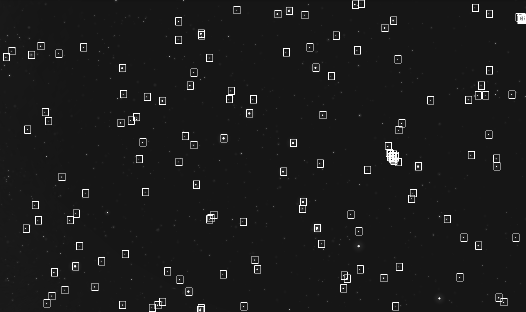
Star 1: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 2: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 3: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 4: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 5: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 6: X: 23 Y: 228 Radius: 1 Brightness: 0
Star 7: X: 45 Y: 204 Radius: 0 Brightness: 0
Star 8: X: 45 Y: 204 Radius: 0 Brightness: 0
Star 9: X: 45 Y: 204 Radius: 0 Brightness: 0
Star 10: X: 102 Y: 914 Radius: 1 Brightness: 0
Star 11: X: 102 Y: 914 Radius: 1 Brightness: 0
Star 12: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 13: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 14: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 15: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 16: X: 108 Y: 518 Radius: 1 Brightness: 0
Star 17: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 18: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 19: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 20: X: 124 Y: 219 Radius: 1 Brightness: 0
Star 21: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 22: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 23: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 24: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 25: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 26: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 27: X: 138 Y: 820 Radius: 0 Brightness: 0
Star 28: X: 151 Y: 881 Radius: 1 Brightness: 0
Star 29: X: 151 Y: 881 Radius: 1 Brightness: 0
Star 30: X: 151 Y: 881 Radius: 1 Brightness: 0
Star 31: X: 161 Y: 184 Radius: 1 Brightness: 0
Star 32: X: 161 Y: 184 Radius: 1 Brightness: 0
Star 33: X: 161 Y: 184 Radius: 1 Brightness: 0
Star 34: X: 161 Y: 184 Radius: 1 Brightness: 0
Star 35: X: 161 Y: 184 Radius: 1 Brightness: 0
Star 36: X: 161 Y: 184 Radius: 1 Brightness: 0
Star 37: X: 178 Y: 448 Radius: 1 Brightness: 0
Star 38: X: 178 Y: 448 Radius: 1 Brightness: 0
Star 39: X: 178 Y: 448 Radius: 1 Brightness: 0
Star 40: X: 178 Y: 448 Radius: 1 Brightness: 0
Star 41: X: 178 Y: 448 Radius: 1 Brightness: 0
Star 42: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 43: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 44: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 45: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 46: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 47: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 48: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 49: X: 185 Y: 1213 Radius: 1 Brightness: 0
Star 50: X: 192 Y: 484 Radius: 1 Brightness: 0
Star 51: X: 192 Y: 484 Radius: 1 Brightness: 0
Star 52: X: 192 Y: 484 Radius: 1 Brightness: 0
Star 53: X: 192 Y: 484 Radius: 1 Brightness: 0
Star 54: X: 205 Y: 1184 Radius: 1 Brightness: 0
Star 55: X: 205 Y: 1184 Radius: 1 Brightness: 0
Star 56: X: 205 Y: 1184 Radius: 1 Brightness: 0
Star 57: X: 205 Y: 1184 Radius: 1 Brightness: 0
Star 58: X: 205 Y: 1184 Radius: 1 Brightness: 0
Star 59: X: 215 Y: 1089 Radius: 1 Brightness: 0
Star 60: X: 215 Y: 1089 Radius: 1 Brightness: 0
Star 61: X: 215 Y: 1089 Radius: 1 Brightness: 0
Star 62: X: 215 Y: 1089 Radius: 1 Brightness: 0
Star 63: X: 215 Y: 1089 Radius: 1 Brightness: 0
Star 64: X: 215 Y: 1089 Radius: 1 Brightness: 0
Star 65: X: 233 Y: 214 Radius: 0 Brightness: 0
Star 66: X: 233 Y: 214 Radius: 0 Brightness: 0
Star 67: X: 233 Y: 214 Radius: 0 Brightness: 0
Star 68: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 69: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 70: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 71: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 72: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 73: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 74: X: 245 Y: 707 Radius: 1 Brightness: 0
Star 75: X: 257 Y: 1160 Radius: 1 Brightness: 0
Star 76: X: 257 Y: 1160 Radius: 1 Brightness: 0
Star 77: X: 257 Y: 1160 Radius: 1 Brightness: 0
Star 78: X: 257 Y: 1160 Radius: 1 Brightness: 0
Star 79: X: 257 Y: 1160 Radius: 1 Brightness: 0
Star 80: X: 278 Y: 880 Radius: 1 Brightness: 0
Star 81: X: 278 Y: 880 Radius: 1 Brightness: 0
Star 82: X: 278 Y: 880 Radius: 1 Brightness: 0
Star 83: X: 278 Y: 880 Radius: 1 Brightness: 0
Star 84: X: 278 Y: 880 Radius: 1 Brightness: 0
Star 85: X: 300 Y: 1065 Radius: 3 Brightness: 0
Star 86: X: 300 Y: 1065 Radius: 3 Brightness: 0
Star 87: X: 300 Y: 1065 Radius: 3 Brightness: 0
Star 88: X: 300 Y: 1065 Radius: 3 Brightness: 0
Star 89: X: 300 Y: 1065 Radius: 3 Brightness: 0
Star 90: X: 302 Y: 854 Radius: 1 Brightness: 0
Star 91: X: 302 Y: 854 Radius: 1 Brightness: 0
Star 92: X: 316 Y: 984 Radius: 1 Brightness: 0
Star 93: X: 316 Y: 984 Radius: 1 Brightness: 0
Star 94: X: 316 Y: 984 Radius: 1 Brightness: 0
Star 95: X: 316 Y: 984 Radius: 1 Brightness: 0
Star 96: X: 332 Y: 189 Radius: 1 Brightness: 0
Star 97: X: 332 Y: 189 Radius: 1 Brightness: 0
Star 98: X: 332 Y: 189 Radius: 1 Brightness: 0
Star 99: X: 332 Y: 189 Radius: 1 Brightness: 0
Star 100: X: 340 Y: 773 Radius: 0 Brightness: 0
Star 101: X: 340 Y: 773 Radius: 0 Brightness: 0
Star 102: X: 340 Y: 773 Radius: 0 Brightness: 0
Star 103: X: 340 Y: 773 Radius: 0 Brightness: 0
Star 104: X: 377 Y: 1147 Radius: 1 Brightness: 0
Star 105: X: 377 Y: 1147 Radius: 1 Brightness: 0
Star 106: X: 377 Y: 1147 Radius: 1 Brightness: 0
Star 107: X: 377 Y: 1147 Radius: 1 Brightness: 0
Star 108: X: 377 Y: 1147 Radius: 1 Brightness: 0
Star 109: X: 404 Y: 1045 Radius: 1 Brightness: 0
Star 110: X: 404 Y: 1045 Radius: 1 Brightness: 0
Star 111: X: 404 Y: 1045 Radius: 1 Brightness: 0
Star 112: X: 404 Y: 1045 Radius: 1 Brightness: 0
Star 113: X: 481 Y: 491 Radius: 1 Brightness: 0
Star 114: X: 481 Y: 491 Radius: 1 Brightness: 0
Star 115: X: 481 Y: 491 Radius: 1 Brightness: 0
Star 116: X: 481 Y: 491 Radius: 1 Brightness: 0
Star 117: X: 481 Y: 491 Radius: 1 Brightness: 0
Star 118: X: 481 Y: 491 Radius: 1 Brightness: 0
Star 119: X: 488 Y: 272 Radius: 2 Brightness: 0
Star 120: X: 488 Y: 272 Radius: 2 Brightness: 0
Star 121: X: 488 Y: 272 Radius: 2 Brightness: 0
Star 122: X: 488 Y: 272 Radius: 2 Brightness: 0
Star 123: X: 488 Y: 272 Radius: 2 Brightness: 0
Star 124: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 125: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 126: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 127: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 128: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 129: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 130: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 131: X: 488 Y: 1219 Radius: 1 Brightness: 0
Star 132: X: 492 Y: 376 Radius: 1 Brightness: 0
Star 133: X: 492 Y: 376 Radius: 1 Brightness: 0
Star 134: X: 492 Y: 376 Radius: 1 Brightness: 0
Star 135: X: 492 Y: 376 Radius: 1 Brightness: 0
Star 136: X: 498 Y: 1016 Radius: 0 Brightness: 0
Star 137: X: 498 Y: 1016 Radius: 0 Brightness: 0
Star 138: X: 498 Y: 1016 Radius: 0 Brightness: 0
Star 139: X: 498 Y: 1016 Radius: 0 Brightness: 0
Star 140: X: 522 Y: 482 Radius: 1 Brightness: 0
Star 141: X: 522 Y: 482 Radius: 1 Brightness: 0
Star 142: X: 522 Y: 482 Radius: 1 Brightness: 0
Star 143: X: 522 Y: 482 Radius: 1 Brightness: 0
Star 144: X: 522 Y: 482 Radius: 1 Brightness: 0
Star 145: X: 522 Y: 482 Radius: 1 Brightness: 0
Star 146: X: 544 Y: 468 Radius: 0 Brightness: 0
Star 147: X: 544 Y: 468 Radius: 0 Brightness: 0
Star 148: X: 544 Y: 468 Radius: 0 Brightness: 0
Star 149: X: 544 Y: 468 Radius: 0 Brightness: 0
Star 150: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 151: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 152: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 153: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 154: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 155: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 156: X: 554 Y: 636 Radius: 0 Brightness: 0
Star 157: X: 569 Y: 569 Radius: 1 Brightness: 0
Star 158: X: 569 Y: 569 Radius: 1 Brightness: 0
Star 159: X: 569 Y: 569 Radius: 1 Brightness: 0
Star 160: X: 569 Y: 569 Radius: 1 Brightness: 0
Star 161: X: 569 Y: 569 Radius: 1 Brightness: 0
Star 162: X: 580 Y: 768 Radius: 1 Brightness: 0
Star 163: X: 580 Y: 768 Radius: 1 Brightness: 0
Star 164: X: 580 Y: 768 Radius: 1 Brightness: 0
Star 165: X: 580 Y: 768 Radius: 1 Brightness: 0
Star 166: X: 586 Y: 387 Radius: 1 Brightness: 0
Star 167: X: 586 Y: 387 Radius: 1 Brightness: 0
Star 168: X: 586 Y: 387 Radius: 1 Brightness: 0
Star 169: X: 606 Y: 1231 Radius: 1 Brightness: 0
Star 170: X: 606 Y: 1231 Radius: 1 Brightness: 0
Star 171: X: 606 Y: 1231 Radius: 1 Brightness: 0
Star 172: X: 629 Y: 1220 Radius: 1 Brightness: 0
Star 173: X: 629 Y: 1220 Radius: 1 Brightness: 0
Star 174: X: 629 Y: 1220 Radius: 1 Brightness: 0
Star 175: X: 629 Y: 1220 Radius: 1 Brightness: 0
Star 176: X: 629 Y: 1220 Radius: 1 Brightness: 0
Star 177: X: 629 Y: 1220 Radius: 1 Brightness: 0
Star 178: X: 648 Y: 403 Radius: 2 Brightness: 0
Star 179: X: 648 Y: 403 Radius: 2 Brightness: 0
Star 180: X: 648 Y: 403 Radius: 2 Brightness: 0
Star 181: X: 648 Y: 403 Radius: 2 Brightness: 0
Star 182: X: 648 Y: 1207 Radius: 1 Brightness: 0
Star 183: X: 648 Y: 1207 Radius: 1 Brightness: 0
Star 184: X: 648 Y: 1207 Radius: 1 Brightness: 0
Star 185: X: 648 Y: 1207 Radius: 1 Brightness: 0
Star 186: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 187: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 188: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 189: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 190: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 191: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 192: X: 668 Y: 1085 Radius: 1 Brightness: 0
Star 193: X: 712 Y: 159 Radius: 1 Brightness: 0
Star 194: X: 712 Y: 85 Radius: 1 Brightness: 0
Star 195: X: 712 Y: 85 Radius: 1 Brightness: 0
Star 196: X: 712 Y: 85 Radius: 1 Brightness: 0
Star 197: X: 712 Y: 85 Radius: 1 Brightness: 0
Star 198: X: 712 Y: 85 Radius: 1 Brightness: 0
Star 199: X: 713 Y: 647 Radius: 1 Brightness: 0
Star 200: X: 713 Y: 647 Radius: 1 Brightness: 0
Star 201: X: 717 Y: 1118 Radius: 1 Brightness: 0
Star 202: X: 717 Y: 1118 Radius: 1 Brightness: 0
Star 203: X: 717 Y: 1118 Radius: 1 Brightness: 0
Star 204: X: 717 Y: 1118 Radius: 1 Brightness: 0
Star 205: X: 717 Y: 1118 Radius: 1 Brightness: 0
Star 206: X: 738 Y: 544 Radius: 1 Brightness: 0
Star 207: X: 738 Y: 544 Radius: 1 Brightness: 0
Star 208: X: 738 Y: 544 Radius: 1 Brightness: 0
Star 209: X: 738 Y: 544 Radius: 1 Brightness: 0
Star 210: X: 738 Y: 544 Radius: 1 Brightness: 0
Star 211: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 212: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 213: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 214: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 215: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 216: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 217: X: 753 Y: 1166 Radius: 3 Brightness: 0
Star 218: X: 758 Y: 342 Radius: 1 Brightness: 0
Star 219: X: 758 Y: 342 Radius: 1 Brightness: 0
Star 220: X: 758 Y: 342 Radius: 1 Brightness: 0
Star 221: X: 758 Y: 342 Radius: 1 Brightness: 0
Star 222: X: 758 Y: 342 Radius: 1 Brightness: 0
Star 223: X: 773 Y: 580 Radius: 1 Brightness: 0
Star 224: X: 773 Y: 580 Radius: 1 Brightness: 0
Star 225: X: 773 Y: 580 Radius: 1 Brightness: 0
Star 226: X: 773 Y: 580 Radius: 1 Brightness: 0
Star 227: X: 773 Y: 580 Radius: 1 Brightness: 0
Star 228: X: 773 Y: 580 Radius: 1 Brightness: 0
Star 229: X: 773 Y: 290 Radius: 1 Brightness: 0
Star 230: X: 773 Y: 290 Radius: 1 Brightness: 0
Star 231: X: 773 Y: 290 Radius: 1 Brightness: 0
Star 232: X: 783 Y: 738 Radius: 1 Brightness: 0
Star 233: X: 783 Y: 738 Radius: 1 Brightness: 0
Star 234: X: 783 Y: 738 Radius: 1 Brightness: 0
Star 235: X: 783 Y: 738 Radius: 1 Brightness: 0
Star 236: X: 783 Y: 738 Radius: 1 Brightness: 0
Star 237: X: 783 Y: 738 Radius: 1 Brightness: 0
Star 238: X: 800 Y: 1240 Radius: 2 Brightness: 0
Star 239: X: 800 Y: 1240 Radius: 2 Brightness: 0
Star 240: X: 800 Y: 1240 Radius: 2 Brightness: 0
Star 241: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 242: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 243: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 244: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 245: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 246: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 247: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 248: X: 802 Y: 134 Radius: 2 Brightness: 0
Star 249: X: 802 Y: 1233 Radius: 1 Brightness: 0
Star 250: X: 802 Y: 1233 Radius: 1 Brightness: 0
Star 251: X: 802 Y: 1233 Radius: 1 Brightness: 0
Star 252: X: 804 Y: 141 Radius: 2 Brightness: 0
Star 253: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 254: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 255: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 256: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 257: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 258: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 259: X: 836 Y: 231 Radius: 1 Brightness: 0
Star 260: X: 836 Y: 877 Radius: 1 Brightness: 0
Star 261: X: 836 Y: 877 Radius: 1 Brightness: 0
Star 262: X: 841 Y: 872 Radius: 1 Brightness: 0
Star 263: X: 841 Y: 872 Radius: 1 Brightness: 0
Star 264: X: 853 Y: 859 Radius: 1 Brightness: 0
Star 265: X: 853 Y: 859 Radius: 1 Brightness: 0
Star 266: X: 853 Y: 859 Radius: 1 Brightness: 0
Star 267: X: 853 Y: 859 Radius: 1 Brightness: 0
Star 268: X: 890 Y: 1097 Radius: 0 Brightness: 0
Star 269: X: 890 Y: 1097 Radius: 0 Brightness: 0
Star 270: X: 890 Y: 1097 Radius: 0 Brightness: 0
Star 271: X: 893 Y: 553 Radius: 3 Brightness: 0
Star 272: X: 893 Y: 553 Radius: 3 Brightness: 0
Star 273: X: 893 Y: 553 Radius: 3 Brightness: 0
Star 274: X: 893 Y: 553 Radius: 3 Brightness: 0
Star 275: X: 893 Y: 553 Radius: 3 Brightness: 0
Star 276: X: 915 Y: 396 Radius: 0 Brightness: 0
Star 277: X: 915 Y: 396 Radius: 0 Brightness: 0
Star 278: X: 915 Y: 396 Radius: 0 Brightness: 0
Star 279: X: 915 Y: 396 Radius: 0 Brightness: 0
Star 280: X: 915 Y: 396 Radius: 0 Brightness: 0
Star 281: X: 922 Y: 363 Radius: 1 Brightness: 0
Star 282: X: 922 Y: 363 Radius: 1 Brightness: 0
Star 283: X: 922 Y: 363 Radius: 1 Brightness: 0
Star 284: X: 945 Y: 40 Radius: 0 Brightness: 0
Star 285: X: 945 Y: 40 Radius: 0 Brightness: 0
Star 286: X: 945 Y: 40 Radius: 0 Brightness: 0
Star 287: X: 970 Y: 887 Radius: 0 Brightness: 0
Star 288: X: 970 Y: 887 Radius: 0 Brightness: 0
Star 289: X: 970 Y: 887 Radius: 0 Brightness: 0
Star 290: X: 970 Y: 887 Radius: 0 Brightness: 0
Star 291: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 292: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 293: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 294: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 295: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 296: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 297: X: 973 Y: 1225 Radius: 1 Brightness: 0
Star 298: X: 996 Y: 453 Radius: 3 Brightness: 0
Star 299: X: 996 Y: 453 Radius: 3 Brightness: 0
Star 300: X: 996 Y: 453 Radius: 3 Brightness: 0
Star 301: X: 996 Y: 453 Radius: 3 Brightness: 0
Star 302: X: 996 Y: 453 Radius: 3 Brightness: 0
Star 303: X: 996 Y: 453 Radius: 3 Brightness: 0
Star 304: X: 1011 Y: 397 Radius: 0 Brightness: 0
Star 305: X: 1011 Y: 397 Radius: 0 Brightness: 0
Star 306: X: 1017 Y: 1039 Radius: 1 Brightness: 0
Star 307: X: 1017 Y: 1039 Radius: 1 Brightness: 0
Star 308: X: 1017 Y: 1039 Radius: 1 Brightness: 0
Star 309: X: 1017 Y: 1039 Radius: 1 Brightness: 0
Star 310: X: 1017 Y: 1039 Radius: 1 Brightness: 0
Star 311: X: 1017 Y: 1039 Radius: 1 Brightness: 0
Star 312: X: 1028 Y: 1077 Radius: 2 Brightness: 0
Star 313: X: 1028 Y: 1077 Radius: 2 Brightness: 0
Star 314: X: 1028 Y: 1077 Radius: 2 Brightness: 0
Star 315: X: 1028 Y: 1077 Radius: 2 Brightness: 0
Star 316: X: 1109 Y: 56 Radius: 2 Brightness: 0
Star 317: X: 1109 Y: 56 Radius: 2 Brightness: 0
Star 318: X: 1109 Y: 56 Radius: 2 Brightness: 0
Star 319: X: 1109 Y: 56 Radius: 2 Brightness: 0
Star 320: X: 1109 Y: 56 Radius: 2 Brightness: 0
Star 321: X: 1109 Y: 56 Radius: 2 Brightness: 0
Star 322: X: 1132 Y: 686 Radius: 2 Brightness: 0
Star 323: X: 1132 Y: 686 Radius: 2 Brightness: 0
Star 324: X: 1132 Y: 686 Radius: 2 Brightness: 0
Star 325: X: 1132 Y: 686 Radius: 2 Brightness: 0
Star 326: X: 1132 Y: 686 Radius: 2 Brightness: 0
Star 327: X: 1132 Y: 686 Radius: 2 Brightness: 0
Star 328: X: 1143 Y: 209 Radius: 0 Brightness: 0
Star 329: X: 1143 Y: 209 Radius: 0 Brightness: 0
Star 330: X: 1143 Y: 209 Radius: 0 Brightness: 0
Star 331: X: 1143 Y: 209 Radius: 0 Brightness: 0
Star 332: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 333: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 334: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 335: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 336: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 337: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 338: X: 1154 Y: 43 Radius: 2 Brightness: 0
Star 339: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 340: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 341: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 342: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 343: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 344: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 345: X: 1171 Y: 571 Radius: 3 Brightness: 0
Star 346: X: 1208 Y: 835 Radius: 1 Brightness: 0
Star 347: X: 1208 Y: 835 Radius: 1 Brightness: 0
Star 348: X: 1208 Y: 835 Radius: 1 Brightness: 0
Star 349: X: 1208 Y: 835 Radius: 1 Brightness: 0
Star 350: X: 1208 Y: 835 Radius: 1 Brightness: 0
Star 351: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 352: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 353: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 354: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 355: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 356: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 357: X: 1211 Y: 807 Radius: 2 Brightness: 0
Star 358: X: 1217 Y: 60 Radius: 1 Brightness: 0
Star 359: X: 1217 Y: 60 Radius: 1 Brightness: 0
Star 360: X: 1217 Y: 60 Radius: 1 Brightness: 0
Star 361: X: 1217 Y: 60 Radius: 1 Brightness: 0
Star 362: X: 1237 Y: 189 Radius: 1 Brightness: 0
Star 363: X: 1237 Y: 189 Radius: 1 Brightness: 0
Star 364: X: 1237 Y: 189 Radius: 1 Brightness: 0
Star 365: X: 1237 Y: 189 Radius: 1 Brightness: 0
Star 366: X: 1237 Y: 189 Radius: 1 Brightness: 0
Star 367: X: 1237 Y: 189 Radius: 1 Brightness: 0
Star 368: X: 1261 Y: 270 Radius: 2 Brightness: 0
Star 369: X: 1261 Y: 270 Radius: 2 Brightness: 0
Star 370: X: 1261 Y: 270 Radius: 2 Brightness: 0
Star 371: X: 1261 Y: 270 Radius: 2 Brightness: 0
Star 372: X: 1261 Y: 270 Radius: 2 Brightness: 0
Star 373: X: 1261 Y: 270 Radius: 2 Brightness: 0
Star 374: X: 1267 Y: 912 Radius: 3 Brightness: 0
Star 375: X: 1267 Y: 912 Radius: 3 Brightness: 0
Star 376: X: 1278 Y: 654 Radius: 1 Brightness: 0
Star 377: X: 1284 Y: 975 Radius: 1 Brightness: 0
Star 378: X: 1284 Y: 975 Radius: 1 Brightness: 0
Star 379: X: 1284 Y: 975 Radius: 1 Brightness: 0
Star 380: X: 1284 Y: 975 Radius: 1 Brightness: 0
Star 381: X: 1289 Y: 460 Radius: 1 Brightness: 0
Star 382: X: 1289 Y: 460 Radius: 1 Brightness: 0
Star 383: X: 1289 Y: 460 Radius: 1 Brightness: 0
Star 384: X: 1289 Y: 460 Radius: 1 Brightness: 0
Star 385: X: 1289 Y: 460 Radius: 1 Brightness: 0
Star 386: X: 1289 Y: 460 Radius: 1 Brightness: 0
Star 387: X: 1323 Y: 304 Radius: 1 Brightness: 0
Star 388: X: 1323 Y: 304 Radius: 1 Brightness: 0
Star 389: X: 1323 Y: 304 Radius: 1 Brightness: 0
Star 390: X: 1342 Y: 142 Radius: 1 Brightness: 0
Star 391: X: 1342 Y: 142 Radius: 1 Brightness: 0
Star 392: X: 1342 Y: 142 Radius: 1 Brightness: 0
Star 393: X: 1372 Y: 1153 Radius: 1 Brightness: 0
Star 394: X: 1372 Y: 1153 Radius: 1 Brightness: 0
Star 395: X: 1372 Y: 1153 Radius: 1 Brightness: 0
Star 396: X: 1372 Y: 1153 Radius: 1 Brightness: 0
Star 397: X: 1372 Y: 1153 Radius: 1 Brightness: 0
Star 398: X: 1372 Y: 1153 Radius: 1 Brightness: 0
Star 399: X: 1374 Y: 1102 Radius: 1 Brightness: 0
Star 400: X: 1374 Y: 1102 Radius: 1 Brightness: 0
Star 401: X: 1374 Y: 1102 Radius: 1 Brightness: 0
Star 402: X: 1374 Y: 1102 Radius: 1 Brightness: 0
Star 403: X: 1374 Y: 1102 Radius: 1 Brightness: 0
Star 404: X: 1374 Y: 1102 Radius: 1 Brightness: 0
Star 405: X: 1386 Y: 1114 Radius: 1 Brightness: 0
Star 406: X: 1386 Y: 1114 Radius: 1 Brightness: 0
Star 407: X: 1401 Y: 858 Radius: 1 Brightness: 0
Star 408: X: 1401 Y: 858 Radius: 1 Brightness: 0
Star 409: X: 1401 Y: 858 Radius: 1 Brightness: 0
Star 410: X: 1401 Y: 858 Radius: 1 Brightness: 0
Star 411: X: 1401 Y: 858 Radius: 1 Brightness: 0
Star 412: X: 1401 Y: 858 Radius: 1 Brightness: 0
Star 413: X: 1419 Y: 18 Radius: 1 Brightness: 0
Star 414: X: 1419 Y: 18 Radius: 1 Brightness: 0
Star 415: X: 1419 Y: 18 Radius: 1 Brightness: 0
Star 416: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 417: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 418: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 419: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 420: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 421: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 422: X: 1427 Y: 201 Radius: 1 Brightness: 0
Star 423: X: 1433 Y: 925 Radius: 1 Brightness: 0
Star 424: X: 1433 Y: 925 Radius: 1 Brightness: 0
Star 425: X: 1433 Y: 925 Radius: 1 Brightness: 0
Star 426: X: 1433 Y: 925 Radius: 1 Brightness: 0
Star 427: X: 1433 Y: 925 Radius: 1 Brightness: 0
Star 428: X: 1433 Y: 925 Radius: 1 Brightness: 0
Star 429: X: 1438 Y: 1077 Radius: 0 Brightness: 0
Star 430: X: 1438 Y: 1077 Radius: 0 Brightness: 0
Star 431: X: 1438 Y: 1077 Radius: 0 Brightness: 0
Star 432: X: 1438 Y: 1077 Radius: 0 Brightness: 0
Star 433: X: 1443 Y: 15 Radius: 1 Brightness: 0
Star 434: X: 1443 Y: 15 Radius: 1 Brightness: 0
Star 435: X: 1443 Y: 15 Radius: 1 Brightness: 0
Star 436: X: 1468 Y: 679 Radius: 0 Brightness: 0
Star 437: X: 1468 Y: 679 Radius: 0 Brightness: 0
Star 438: X: 1468 Y: 679 Radius: 0 Brightness: 0
Star 439: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 440: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 441: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 442: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 443: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 444: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 445: X: 1533 Y: 1112 Radius: 1 Brightness: 0
Star 446: X: 1537 Y: 111 Radius: 2 Brightness: 0
Star 447: X: 1537 Y: 111 Radius: 2 Brightness: 0
Star 448: X: 1537 Y: 111 Radius: 2 Brightness: 0
Star 449: X: 1537 Y: 111 Radius: 2 Brightness: 0
Star 450: X: 1537 Y: 111 Radius: 2 Brightness: 0
Star 451: X: 1537 Y: 111 Radius: 2 Brightness: 0
Star 452: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 453: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 454: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 455: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 456: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 457: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 458: X: 1550 Y: 584 Radius: 1 Brightness: 0
Star 459: X: 1554 Y: 611 Radius: 1 Brightness: 0
Star 460: X: 1559 Y: 617 Radius: 3 Brightness: 0
Star 461: X: 1559 Y: 617 Radius: 3 Brightness: 0
Star 462: X: 1560 Y: 628 Radius: 2 Brightness: 0
Star 463: X: 1565 Y: 630 Radius: 1 Brightness: 0
Star 464: X: 1566 Y: 636 Radius: 1 Brightness: 0
Star 465: X: 1567 Y: 625 Radius: 1 Brightness: 0
Star 466: X: 1571 Y: 618 Radius: 3 Brightness: 0
Star 467: X: 1571 Y: 637 Radius: 1 Brightness: 0
Star 468: X: 1571 Y: 637 Radius: 1 Brightness: 0
Star 469: X: 1572 Y: 82 Radius: 1 Brightness: 0
Star 470: X: 1572 Y: 82 Radius: 1 Brightness: 0
Star 471: X: 1572 Y: 82 Radius: 1 Brightness: 0
Star 472: X: 1572 Y: 82 Radius: 1 Brightness: 0
Star 473: X: 1572 Y: 82 Radius: 1 Brightness: 0
Star 474: X: 1572 Y: 82 Radius: 1 Brightness: 0
Star 475: X: 1572 Y: 630 Radius: 3 Brightness: 0
Star 476: X: 1572 Y: 630 Radius: 3 Brightness: 0
Star 477: X: 1573 Y: 642 Radius: 2 Brightness: 0
Star 478: X: 1578 Y: 623 Radius: 1 Brightness: 0
Star 479: X: 1579 Y: 629 Radius: 1 Brightness: 0
Star 480: X: 1579 Y: 629 Radius: 1 Brightness: 0
Star 481: X: 1580 Y: 1225 Radius: 0 Brightness: 0
Star 482: X: 1580 Y: 1225 Radius: 0 Brightness: 0
Star 483: X: 1580 Y: 1225 Radius: 0 Brightness: 0
Star 484: X: 1580 Y: 1225 Radius: 0 Brightness: 0
Star 485: X: 1589 Y: 237 Radius: 0 Brightness: 0
Star 486: X: 1589 Y: 237 Radius: 0 Brightness: 0
Star 487: X: 1589 Y: 237 Radius: 0 Brightness: 0
Star 488: X: 1589 Y: 237 Radius: 0 Brightness: 0
Star 489: X: 1589 Y: 237 Radius: 0 Brightness: 0
Star 490: X: 1590 Y: 648 Radius: 1 Brightness: 0
Star 491: X: 1593 Y: 520 Radius: 1 Brightness: 0
Star 492: X: 1594 Y: 1067 Radius: 1 Brightness: 0
Star 493: X: 1594 Y: 1067 Radius: 1 Brightness: 0
Star 494: X: 1594 Y: 1067 Radius: 1 Brightness: 0
Star 495: X: 1594 Y: 1067 Radius: 1 Brightness: 0
Star 496: X: 1594 Y: 1067 Radius: 1 Brightness: 0
Star 497: X: 1594 Y: 1067 Radius: 1 Brightness: 0
Star 498: X: 1605 Y: 493 Radius: 1 Brightness: 0
Star 499: X: 1605 Y: 493 Radius: 1 Brightness: 0
Star 500: X: 1605 Y: 493 Radius: 1 Brightness: 0
Star 501: X: 1644 Y: 795 Radius: 1 Brightness: 0
Star 502: X: 1644 Y: 795 Radius: 1 Brightness: 0
Star 503: X: 1644 Y: 795 Radius: 1 Brightness: 0
Star 504: X: 1644 Y: 795 Radius: 1 Brightness: 0
Star 505: X: 1644 Y: 795 Radius: 1 Brightness: 0
Star 506: X: 1644 Y: 795 Radius: 1 Brightness: 0
Star 507: X: 1650 Y: 772 Radius: 1 Brightness: 0
Star 508: X: 1650 Y: 772 Radius: 1 Brightness: 0
Star 509: X: 1650 Y: 772 Radius: 1 Brightness: 0
Star 510: X: 1650 Y: 772 Radius: 1 Brightness: 0
Star 511: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 512: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 513: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 514: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 515: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 516: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 517: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 518: X: 1671 Y: 665 Radius: 3 Brightness: 0
Star 519: X: 1720 Y: 401 Radius: 1 Brightness: 0
Star 520: X: 1720 Y: 401 Radius: 1 Brightness: 0
Star 521: X: 1720 Y: 401 Radius: 1 Brightness: 0
Star 522: X: 1786 Y: 876 Radius: 1 Brightness: 0
Star 523: X: 1786 Y: 876 Radius: 1 Brightness: 0
Star 524: X: 1786 Y: 876 Radius: 1 Brightness: 0
Star 525: X: 1837 Y: 1109 Radius: 1 Brightness: 0
Star 526: X: 1837 Y: 1109 Radius: 1 Brightness: 0
Star 527: X: 1853 Y: 950 Radius: 1 Brightness: 0
Star 528: X: 1853 Y: 950 Radius: 1 Brightness: 0
Star 529: X: 1853 Y: 950 Radius: 1 Brightness: 0
Star 530: X: 1853 Y: 950 Radius: 1 Brightness: 0
Star 531: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 532: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 533: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 534: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 535: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 536: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 537: X: 1872 Y: 399 Radius: 1 Brightness: 0
Star 538: X: 1882 Y: 620 Radius: 1 Brightness: 0
Star 539: X: 1882 Y: 620 Radius: 1 Brightness: 0
Star 540: X: 1882 Y: 620 Radius: 1 Brightness: 0
Star 541: X: 1899 Y: 31 Radius: 0 Brightness: 0
Star 542: X: 1899 Y: 31 Radius: 0 Brightness: 0
Star 543: X: 1899 Y: 31 Radius: 0 Brightness: 0
Star 544: X: 1899 Y: 31 Radius: 0 Brightness: 0
Star 545: X: 1899 Y: 31 Radius: 0 Brightness: 0
Star 546: X: 1899 Y: 31 Radius: 0 Brightness: 0
Star 547: X: 1910 Y: 381 Radius: 1 Brightness: 0
Star 548: X: 1910 Y: 381 Radius: 1 Brightness: 0
Star 549: X: 1910 Y: 381 Radius: 1 Brightness: 0
Star 550: X: 1910 Y: 381 Radius: 1 Brightness: 0
Star 551: X: 1910 Y: 381 Radius: 1 Brightness: 0
Star 552: X: 1912 Y: 982 Radius: 1 Brightness: 0
Star 553: X: 1912 Y: 982 Radius: 1 Brightness: 0
Star 554: X: 1912 Y: 982 Radius: 1 Brightness: 0
Star 555: X: 1912 Y: 982 Radius: 1 Brightness: 0
Star 556: X: 1912 Y: 982 Radius: 1 Brightness: 0
Star 557: X: 1912 Y: 982 Radius: 1 Brightness: 0
Star 558: X: 1923 Y: 342 Radius: 1 Brightness: 0
Star 559: X: 1923 Y: 342 Radius: 1 Brightness: 0
Star 560: X: 1923 Y: 342 Radius: 1 Brightness: 0
Star 561: X: 1923 Y: 342 Radius: 1 Brightness: 0
Star 562: X: 1940 Y: 381 Radius: 1 Brightness: 0
Star 563: X: 1953 Y: 538 Radius: 1 Brightness: 0
Star 564: X: 1953 Y: 538 Radius: 1 Brightness: 0
Star 565: X: 1953 Y: 538 Radius: 1 Brightness: 0
Star 566: X: 1953 Y: 538 Radius: 1 Brightness: 0
Star 567: X: 1955 Y: 55 Radius: 1 Brightness: 0
Star 568: X: 1955 Y: 55 Radius: 1 Brightness: 0
Star 569: X: 1955 Y: 55 Radius: 1 Brightness: 0
Star 570: X: 1955 Y: 55 Radius: 1 Brightness: 0
Star 571: X: 1955 Y: 281 Radius: 1 Brightness: 0
Star 572: X: 1955 Y: 281 Radius: 1 Brightness: 0
Star 573: X: 1955 Y: 281 Radius: 1 Brightness: 0
Star 574: X: 1955 Y: 281 Radius: 1 Brightness: 0
Star 575: X: 1955 Y: 281 Radius: 1 Brightness: 0
Star 576: X: 1955 Y: 281 Radius: 1 Brightness: 0
Star 577: X: 1984 Y: 634 Radius: 1 Brightness: 0
Star 578: X: 1984 Y: 634 Radius: 1 Brightness: 0
Star 579: X: 1984 Y: 634 Radius: 1 Brightness: 0
Star 580: X: 1984 Y: 634 Radius: 1 Brightness: 0
Star 581: X: 1984 Y: 634 Radius: 1 Brightness: 0
Star 582: X: 1984 Y: 634 Radius: 1 Brightness: 0
Star 583: X: 1985 Y: 665 Radius: 1 Brightness: 0
Star 584: X: 1985 Y: 665 Radius: 1 Brightness: 0
Star 585: X: 1985 Y: 665 Radius: 1 Brightness: 0
Star 586: X: 1985 Y: 665 Radius: 1 Brightness: 0
Star 587: X: 1993 Y: 1190 Radius: 2 Brightness: 0
Star 588: X: 1993 Y: 1190 Radius: 2 Brightness: 0
Star 589: X: 1993 Y: 1190 Radius: 2 Brightness: 0
Star 590: X: 1993 Y: 1190 Radius: 2 Brightness: 0
Star 591: X: 2013 Y: 1208 Radius: 1 Brightness: 0
Star 592: X: 2013 Y: 1208 Radius: 1 Brightness: 0
Star 593: X: 2045 Y: 378 Radius: 1 Brightness: 0
Star 594: X: 2045 Y: 378 Radius: 1 Brightness: 0
Star 595: X: 2045 Y: 378 Radius: 1 Brightness: 0
Star 596: X: 2045 Y: 378 Radius: 1 Brightness: 0
Star 597: X: 2061 Y: 950 Radius: 1 Brightness: 0
Star 598: X: 2061 Y: 950 Radius: 1 Brightness: 0
Star 599: X: 2061 Y: 950 Radius: 1 Brightness: 0
Star 600: X: 2061 Y: 950 Radius: 1 Brightness: 0
Star 601: X: 2073 Y: 69 Radius: 1 Brightness: 0
Star 602: X: 2078 Y: 77 Radius: 1 Brightness: 0
Star 603: X: 2078 Y: 77 Radius: 1 Brightness: 0
Star 604: X: 2078 Y: 77 Radius: 1 Brightness: 0
Star 605: X: 2078 Y: 70 Radius: 1 Brightness: 0
Star 606: X: 2084 Y: 79 Radius: 1 Brightness: 0
Star 607: X: 2084 Y: 79 Radius: 1 Brightness: 0
Star 608: X: 2084 Y: 68 Radius: 1 Brightness: 0
Star 609: X: 2087 Y: 74 Radius: 2 Brightness: 0
Star 610: X: 2093 Y: 76 Radius: 1 Brightness: 0
Star 611: X: 2097 Y: 73 Radius: 1 Brightness: 0
Star 612: X: 2097 Y: 73 Radius: 1 Brightness: 0
Star 613: X: 2097 Y: 70 Radius: 1 Brightness: 0
Star 614: X: 2097 Y: 79 Radius: 1 Brightness: 0
Star 615: X: 2097 Y: 76 Radius: 0 Brightness: 0


# **step B - find triangels**

**Step B:** Finding a group **T1**,**T2** triangles whose vertices are the stars for each image.

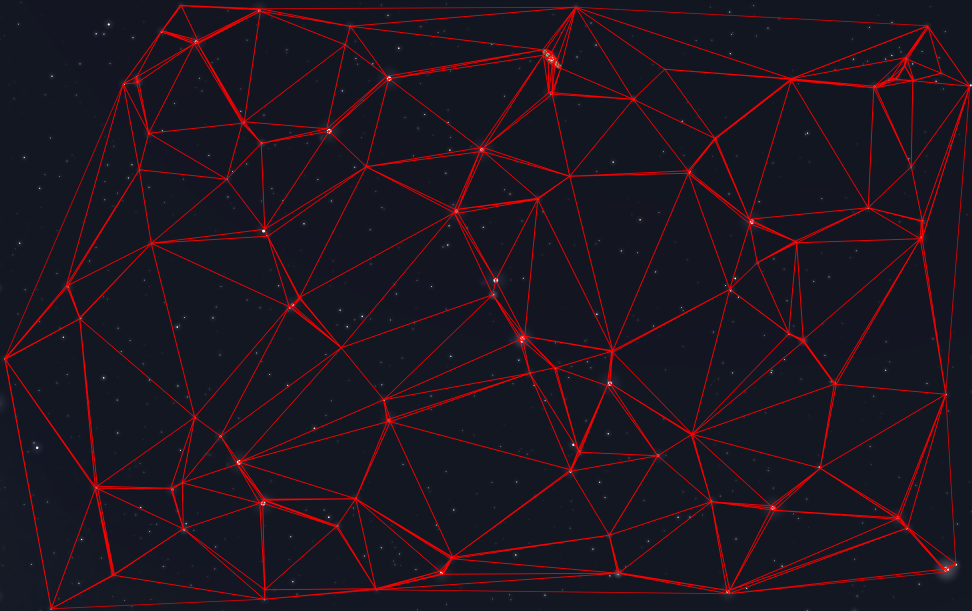

array([[[33, 22, 18],
        [33, 22, 18],
        [33, 22, 18],
        ...,
        [32, 21, 17],
        [32, 21, 17],
        [32, 21, 17]],

       [[33, 23, 19],
        [33, 23, 19],
        [33, 23, 19],
        ...,
        [32, 22, 18],
        [32, 22, 18],
        [32, 22, 18]],

       [[34, 23, 19],
        [34, 23, 19],
        [34, 23, 19],
        ...,
        [33, 22, 18],
        [33, 22, 18],
        [33, 22, 18]],

       ...,

       [[37, 26, 21],
        [37, 26, 21],
        [37, 26, 21],
        ...,
        [35, 24, 20],
        [35, 24, 20],
        [35, 24, 20]],

       [[37, 26, 21],
        [37, 26, 21],
        [37, 26, 21],
        ...,
        [35, 24, 20],
        [35, 24, 20],
        [35, 24, 20]],

       [[37, 26, 21],
        [37, 26, 21],
        [37, 26, 21],
        ...,
        [35, 24, 20],
        [35, 24, 20],
        [35, 24, 20]]], dtype=uint8)

In [ ]:
"""
The function receives an image and performs noise filtering and image processing
"""
def load_image(image):
    # Load image
    img = cv2.imread(image, cv2.IMREAD_GRAYSCALE)
    # Apply binary thresholding to convert to black and white
    # ret, img = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
    # define structuring element for morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
    # perform morphological opening to remove small spots
    opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
    return opening

"""
The function receives a processed image using the load_image function.
Outputs coordinates of stars in SIFT means.
 Creates patterns of triangles using three stars
"""
def create_triangle(image,sigma):
    img = cv2.imread(image)
    filtered_img = load_image(image)

    #The cv2.SIFT_create() function creates a SIFT object that can be used to detect keypoints
    # and extract descriptors from images using the SIFT algorithm.
    # The sigma parameter sets the scale of the difference of Gaussians used to detect keypoints

    sift = cv2.SIFT_create(sigma=sigma)
    kp = sift.detect(filtered_img, None)
    # sort the stars by response
    kp_filter = sorted(kp, key=lambda x: x.size, reverse=True)

    # Get keypoints coordinates as a NumPy array
    pts = np.array([k.pt for k in kp[:]], dtype=np.float32)

    # Compute Delaunay triangulation of the keypoints
    tri = cv2.Subdiv2D((0, 0, img.shape[1], img.shape[0]))
    tri.insert(pts)
    triangle_list = tri.getTriangleList()
    return triangle_list, kp, img



"""
get an image and a list of triangles and draws triangles on the image based on those keypoints:
"""
def draw_triangles(image, triangles):
    # Convert image to grayscale

    # Create a copy of the original image to draw on
    img_copy = image.copy()


    # Draw the triangles on the copy of the image
    for triangle in triangles:
        pt1 = (int(triangle[0]), int(triangle[1]))
        pt2 = (int(triangle[2]), int(triangle[3]))
        pt3 = (int(triangle[4]), int(triangle[5]))
        cv2.line(img_copy, pt1, pt2, (0, 0, 255), 1, cv2.LINE_AA)
        cv2.line(img_copy, pt2, pt3, (0, 0, 255), 1, cv2.LINE_AA)
        cv2.line(img_copy, pt3, pt1, (0, 0, 255), 1, cv2.LINE_AA)
    image_with_lines_resized = cv2.resize(img_copy, (0, 0), fx=0.50, fy=0.50)
    cv2_imshow(image_with_lines_resized)
    # Return the copy of the image with the triangles drawn on it
    return image_with_lines_resized


triangle_list, kp, img = create_triangle('/content/drive/MyDrive/Colab Notebooks/ST_db1.png',0.9)
draw_triangles(img, triangle_list)


array([[[33, 22, 18],
        [33, 22, 18],
        [33, 22, 18],
        ...,
        [32, 21, 17],
        [32, 21, 17],
        [32, 21, 17]],

       [[33, 23, 19],
        [33, 23, 19],
        [33, 23, 19],
        ...,
        [32, 22, 18],
        [32, 22, 18],
        [32, 22, 18]],

       [[34, 23, 19],
        [34, 23, 19],
        [34, 23, 19],
        ...,
        [33, 22, 18],
        [33, 22, 18],
        [33, 22, 18]],

       ...,

       [[37, 26, 21],
        [37, 26, 21],
        [37, 26, 21],
        ...,
        [35, 24, 20],
        [35, 24, 20],
        [35, 24, 20]],

       [[37, 26, 21],
        [37, 26, 21],
        [37, 26, 21],
        ...,
        [35, 24, 20],
        [35, 24, 20],
        [35, 24, 20]],

       [[37, 26, 21],
        [37, 26, 21],
        [37, 26, 21],
        ...,
        [35, 24, 20],
        [35, 24, 20],
        [35, 24, 20]]], 

## **Star tracker code**
**Step C:**
Finding the group of **similar triangles** from **T1**,**T2** according to sides.

**Step D:** Performing a **linear transformation** between two similar triangles **t1**,**t2**, in 6 points
and finding the common stars

**Step E:**  **Repeat** step **D** until finding the **best** transformationn

Run to view results

D.B


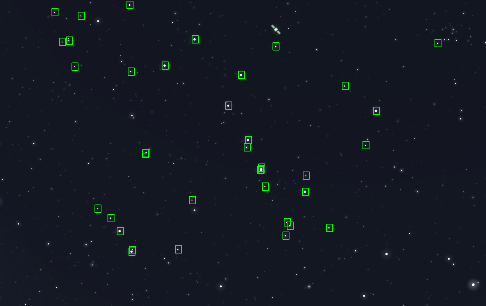

MATCH


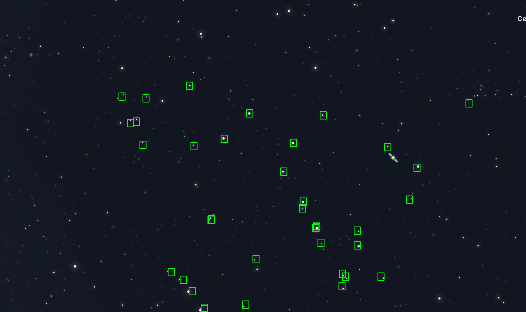

-----Common Stars-----
X: 485.634765625, Y: 386.4892883300781, Size: 1.0, Response: 0.0
X: 485.634765625, Y: 386.4892883300781, Size: 1.0, Response: 0.0
X: 485.634765625, Y: 386.4892883300781, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 569.6593017578125, Y: 579.0014038085938, Size: 1.0, Response: 0.0
X: 569.6593017578125, Y

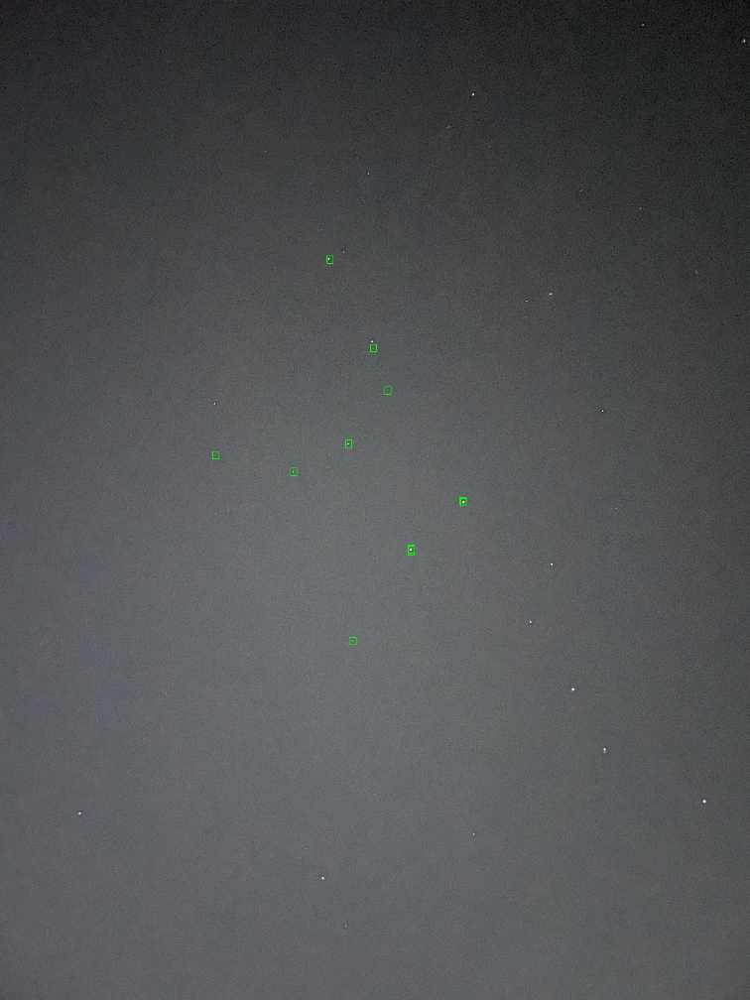

MATCH


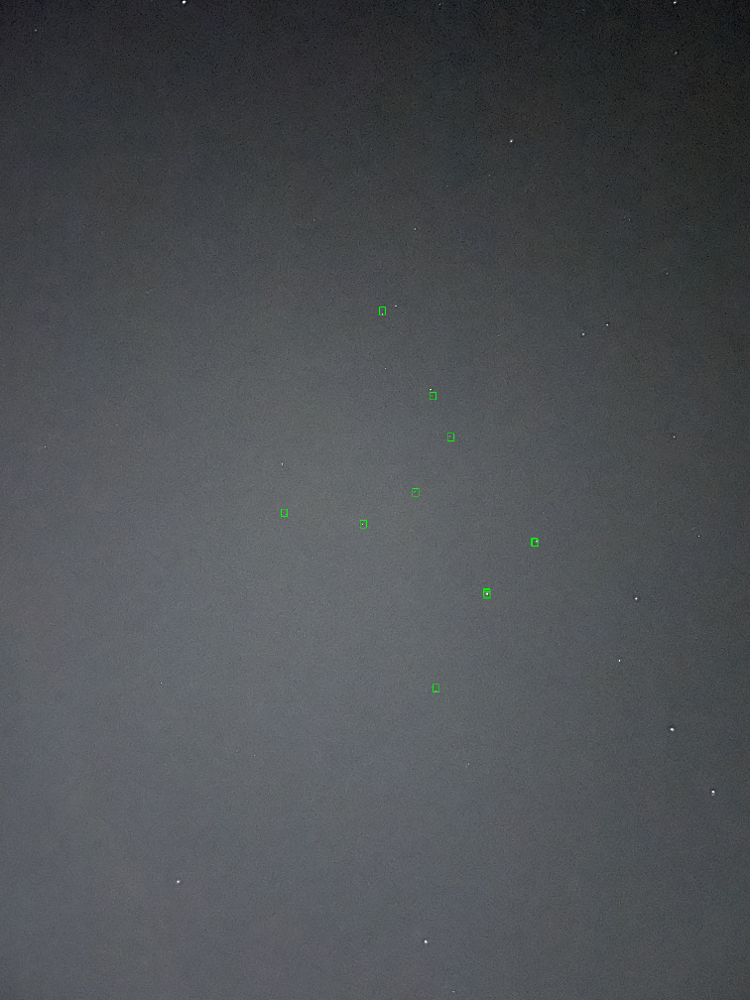

-----Common Stars-----
X: 1143.92236328125, Y: 2067.62255859375, Size: 1.0, Response: 0.0
X: 1143.92236328125, Y: 2067.62255859375, Size: 1.0, Response: 0.0
X: 1143.92236328125, Y: 2067.62255859375, Size: 1.0, Response: 0.0
X: 1462.1644287109375, Y: 2113.41259765625, Size: 1.0, Response: 0.0
X: 1462.1644287109375, Y: 2113.41259765625, Size: 1.0, Response: 0.0
X: 1539.2288818359375, Y: 1253.3363037109375, Size: 1.0, Response: 0.0
X: 1673.873291015625, Y: 1985.8780517578125, Size: 1.0, Response: 0.0
X: 1673.873291015625, Y: 1985.8780517578125, Size: 1.0, Response: 0.0
X: 1756.657958984375, Y: 2774.114990234375, Size: 1.0, Response: 0.0
X: 1756.657958984375, Y: 2774.114990234375, Size: 1.0, Response: 0.0
X: 1756.657958984375, Y: 2774.114990234375, Size: 1.0, Response: 0.0
X: 1742.90771484375, Y: 1596.1920166015625, Size: 1.0, Response: 0.0
X: 1742.90771484375, Y: 1596.1920166015625, Size: 1.0, Response: 0.0
X: 1742.90771484375, Y: 1596.1920166015625, Size: 1.0, Response: 0.0
X: 1742.90771

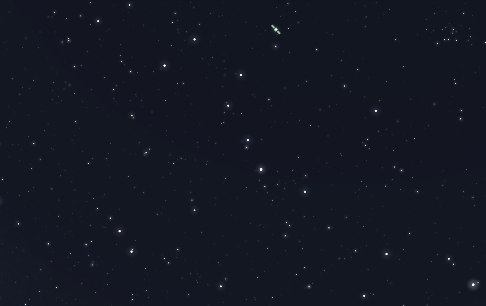

MATCH


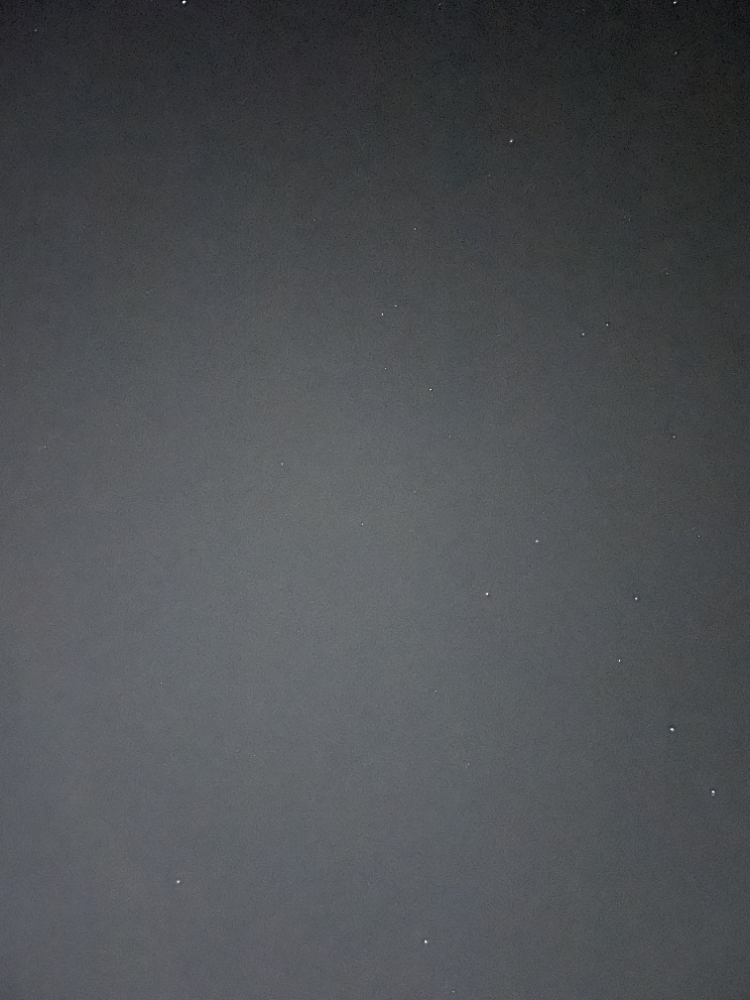

-----Common Stars-----
D.B


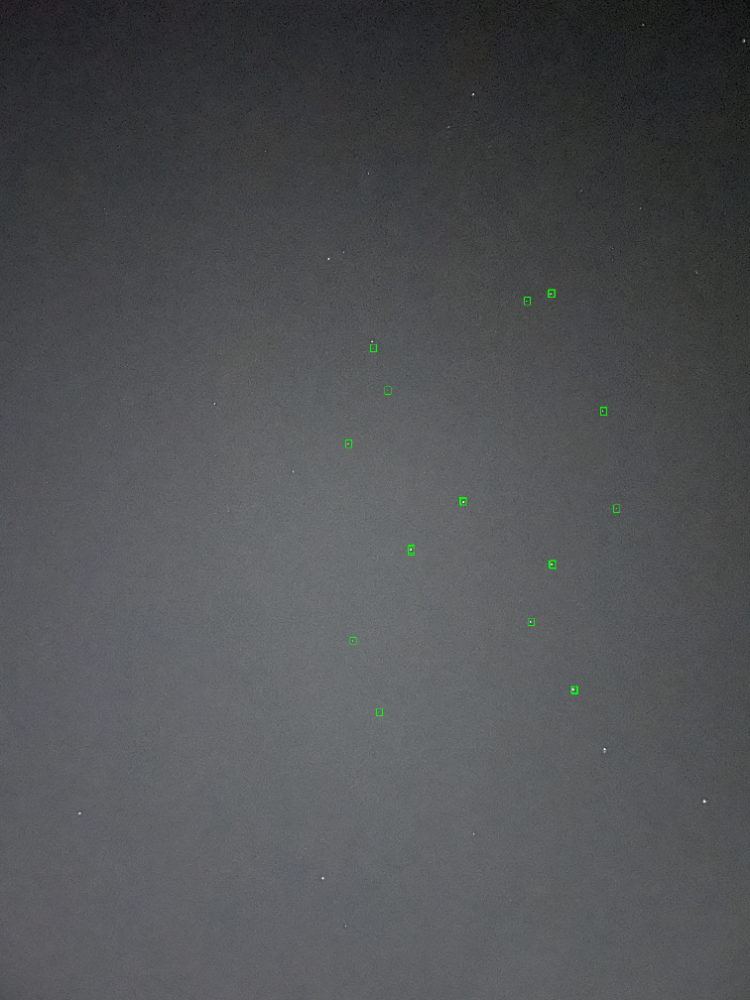

MATCH


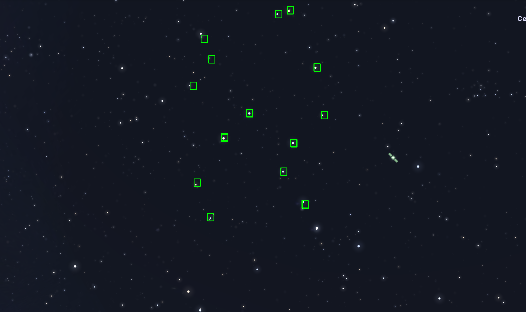

-----Common Stars-----
X: 770.0067138671875, Y: 343.666015625, Size: 1.0, Response: 0.0
X: 770.0067138671875, Y: 343.666015625, Size: 1.0, Response: 0.0
X: 786.4678955078125, Y: 730.1809692382812, Size: 1.0, Response: 0.0
X: 786.4678955078125, Y: 730.1809692382812, Size: 1.0, Response: 0.0
X: 786.4678955078125, Y: 730.1809692382812, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 840.1829223632812, Y: 868.8390502929688, Size: 1.0, Response: 0.0
X: 840.1829223632812, Y: 868.8390502929688, Size: 1.0, Response: 0.0
X: 844.4760131835938, Y: 237.70855712890625, Size: 1.0, Response: 0.0
X: 844.4760131835938, Y: 237.70855712890625, Size: 1.0, Response: 0.0
X: 844.47601

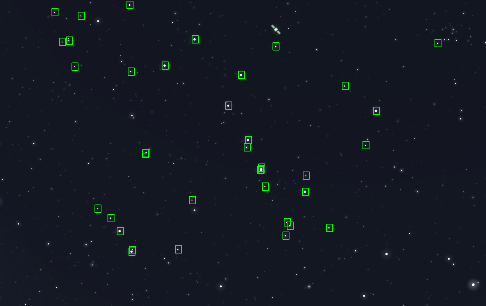

MATCH


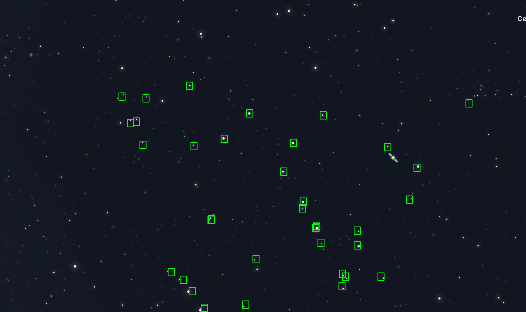

-----Common Stars-----
X: 485.634765625, Y: 386.4892883300781, Size: 1.0, Response: 0.0
X: 485.634765625, Y: 386.4892883300781, Size: 1.0, Response: 0.0
X: 485.634765625, Y: 386.4892883300781, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 519.3818969726562, Y: 492.5613098144531, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 543.9216918945312, Y: 486.6161193847656, Size: 1.0, Response: 0.0
X: 569.6593017578125, Y: 579.0014038085938, Size: 1.0, Response: 0.0
X: 569.6593017578125, Y

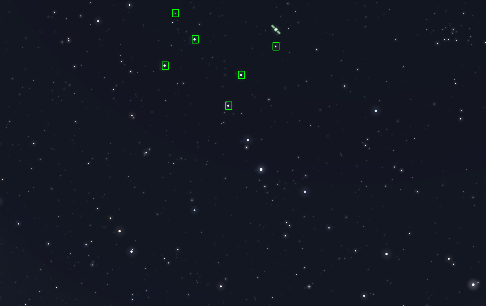

MATCH


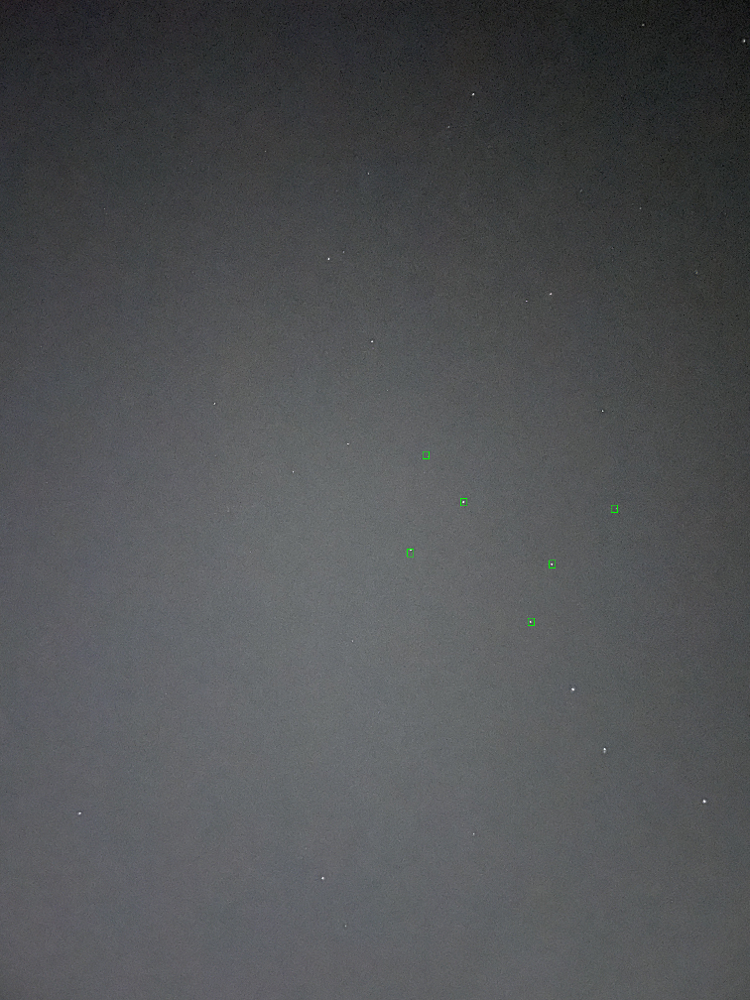

-----Common Stars-----
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1652.1187744140625, Y: 2229.10009765625, Size: 1.0, Response: 0.0
X: 1714.462158203125, Y: 1835.4755859375, Size: 1.0, Response: 0.0
X: 1714.462158203125, Y: 1835.4755859375, Size: 1.0, Response: 0.0
X: 1714.462158203125, Y: 1835.4755859375, Size: 1.0, Response: 0.0
X: 1714.462158203125, Y: 1835.4755859375, Size: 1.0, Response: 0.0
X: 1714.462158203125, Y: 1835.4755859375, Size: 1.0, Response: 0.0
X: 1868.4447021484375, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.4447021484375, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.444702148

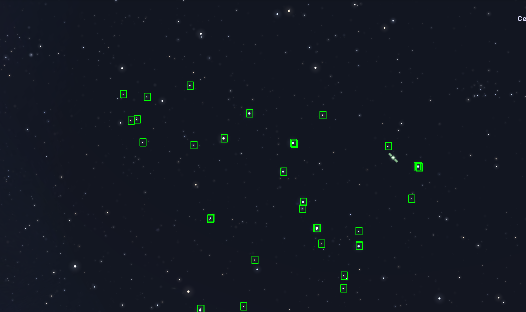

MATCH


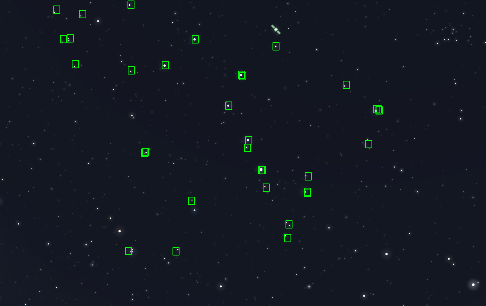

-----Common Stars-----
X: 224.873779296875, Y: 38.734161376953125, Size: 1.0, Response: 0.0
X: 224.873779296875, Y: 38.734161376953125, Size: 1.0, Response: 0.0
X: 224.873779296875, Y: 38.734161376953125, Size: 1.0, Response: 0.0
X: 224.873779296875, Y: 38.734161376953125, Size: 1.0, Response: 0.0
X: 224.873779296875, Y: 38.734161376953125, Size: 1.0, Response: 0.0
X: 224.873779296875, Y: 38.734161376953125, Size: 1.0, Response: 0.0
X: 251.76611328125, Y: 156.95989990234375, Size: 1.0, Response: 0.0
X: 251.76611328125, Y: 156.95989990234375, Size: 1.0, Response: 0.0
X: 251.76611328125, Y: 156.95989990234375, Size: 1.0, Response: 0.0
X: 251.76611328125, Y: 156.95989990234375, Size: 1.0, Response: 0.0
X: 251.76611328125, Y: 156.95989990234375, Size: 1.0, Response: 0.0
X: 251.91485595703125, Y: 156.82867431640625, Size: 1.0, Response: 0.0
X: 251.91485595703125, Y: 156.82867431640625, Size: 1.0, Response: 0.0
X: 251.91485595703125, Y: 156.82867431640625, Size: 1.0, Response: 0.0
X: 251.914

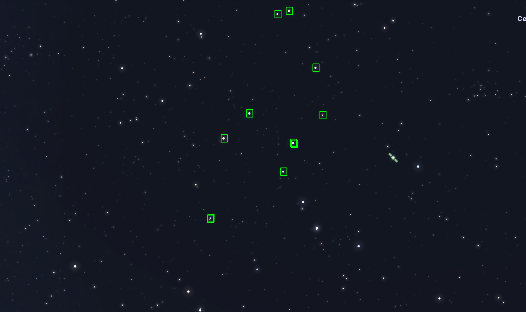

MATCH


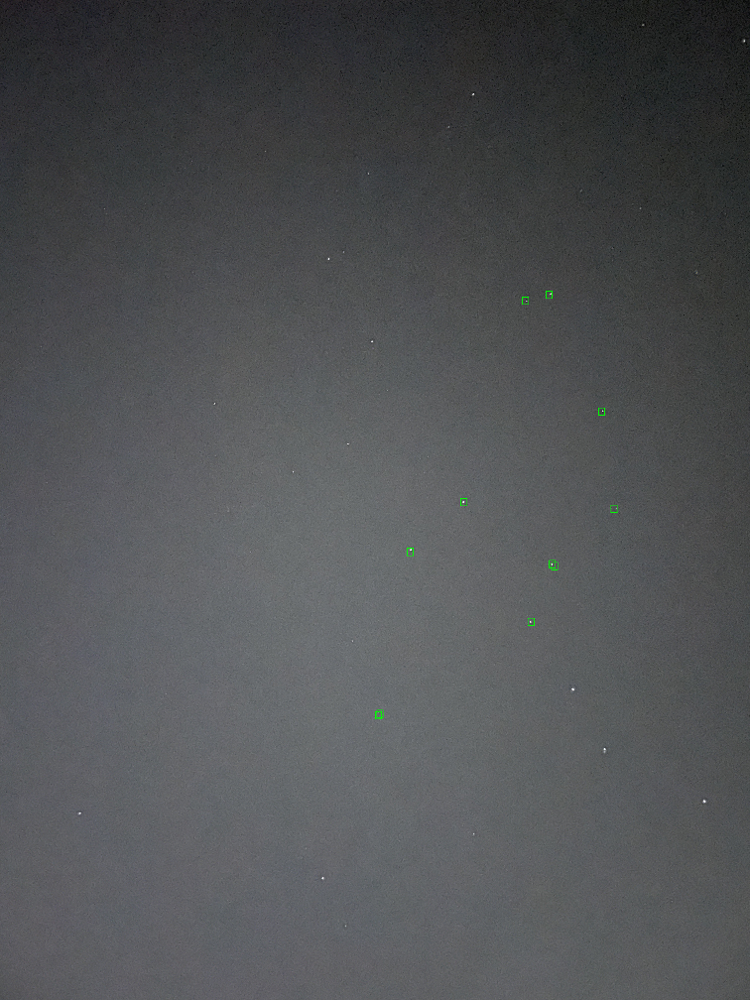

-----Common Stars-----
X: 1523.8782958984375, Y: 2884.025390625, Size: 1.0, Response: 0.0
X: 1529.5965576171875, Y: 2878.01953125, Size: 1.0, Response: 0.0
X: 1651.7593994140625, Y: 2225.03662109375, Size: 1.0, Response: 0.0
X: 1651.7593994140625, Y: 2225.03662109375, Size: 1.0, Response: 0.0
X: 1868.4447021484375, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.4447021484375, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.4447021484375, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.4447021484375, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 2116.8115234375, Y: 1212.1324462890625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2211.64111328125, Y: 1188.87353515625, Size: 1.0, Response: 0.0
X: 2211.64111328125, Y: 1188.87353515625, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y:

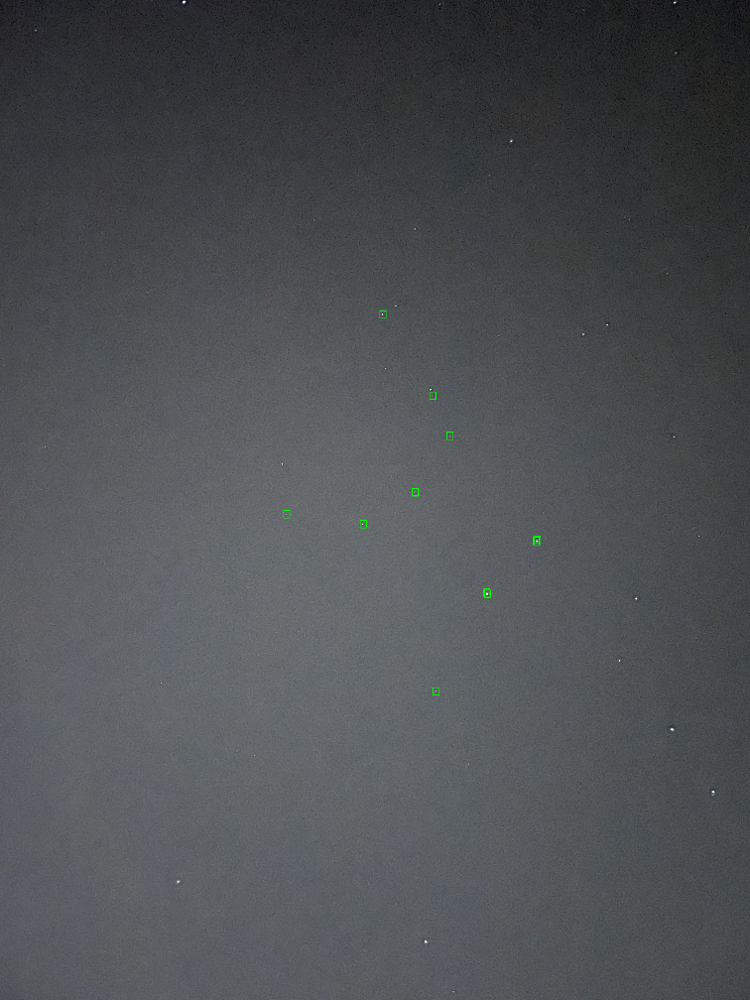

MATCH


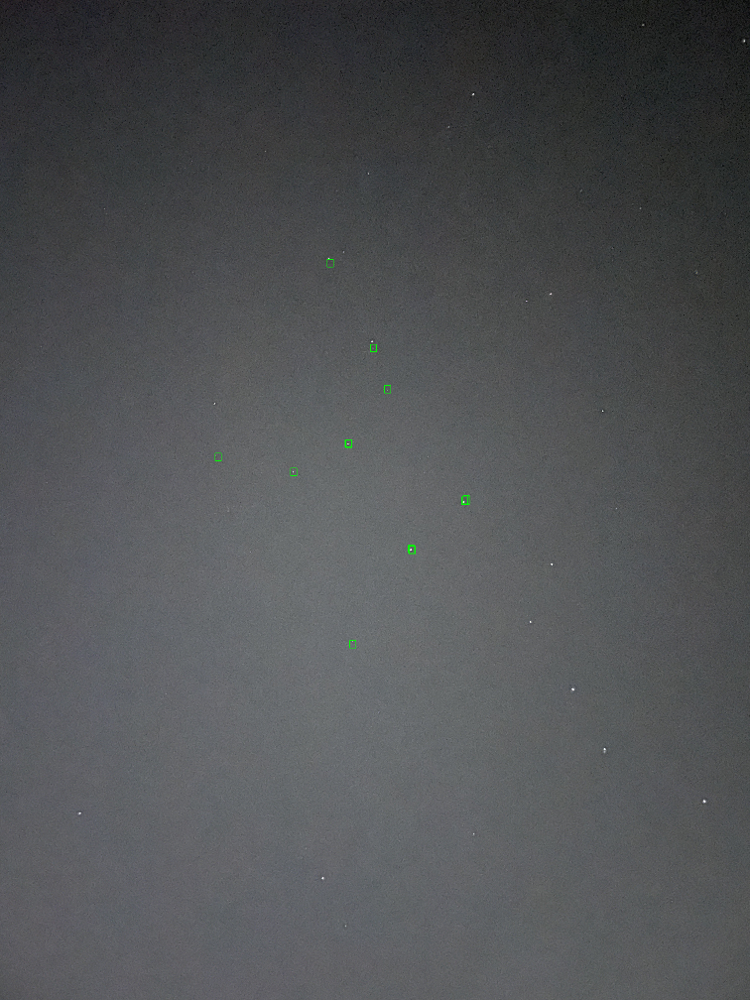

-----Common Stars-----
X: 877.7660522460938, Y: 1842.43212890625, Size: 1.0, Response: 0.0
X: 877.7660522460938, Y: 1842.43212890625, Size: 1.0, Response: 0.0
X: 1181.8939208984375, Y: 1902.941162109375, Size: 1.0, Response: 0.0
X: 1181.8939208984375, Y: 1902.941162109375, Size: 1.0, Response: 0.0
X: 1181.8939208984375, Y: 1902.941162109375, Size: 1.0, Response: 0.0
X: 1181.8939208984375, Y: 1902.941162109375, Size: 1.0, Response: 0.0
X: 1329.7332763671875, Y: 1061.79345703125, Size: 1.0, Response: 0.0
X: 1329.7332763671875, Y: 1061.79345703125, Size: 1.0, Response: 0.0
X: 1401.10107421875, Y: 1787.19140625, Size: 1.0, Response: 0.0
X: 1401.10107421875, Y: 1787.19140625, Size: 1.0, Response: 0.0
X: 1401.10107421875, Y: 1787.19140625, Size: 1.0, Response: 0.0
X: 1403.4107666015625, Y: 1789.437744140625, Size: 1.0, Response: 0.0
X: 1503.1541748046875, Y: 1403.1546630859375, Size: 1.0, Response: 0.0
X: 1503.1541748046875, Y: 1403.1546630859375, Size: 1.0, Response: 0.0
X: 1420.29943847656

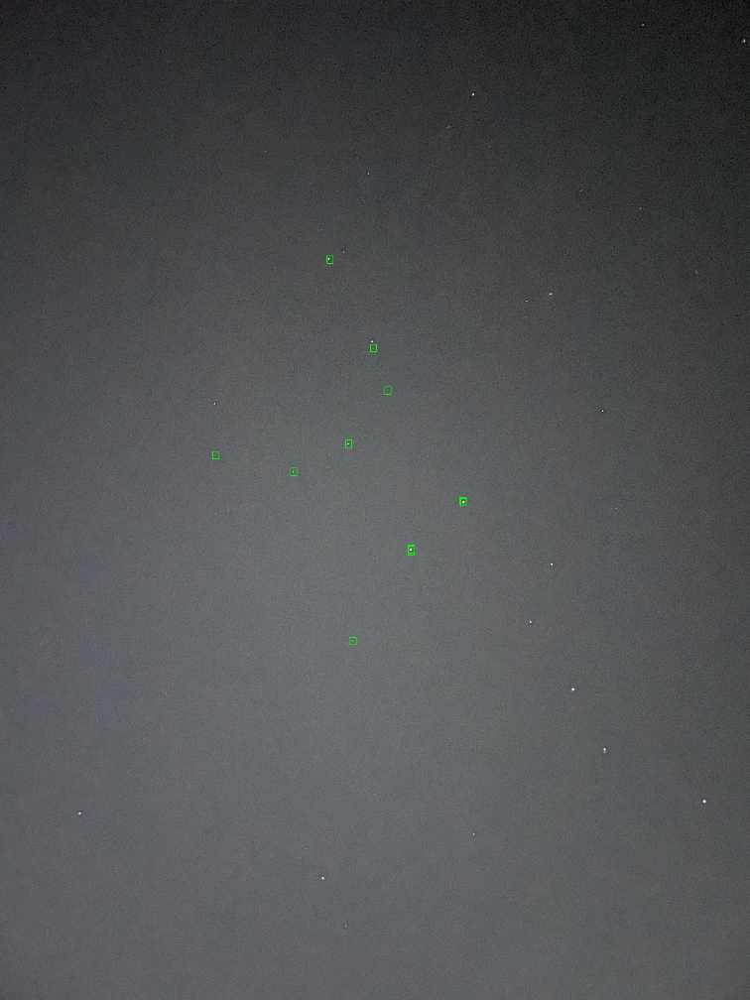

MATCH


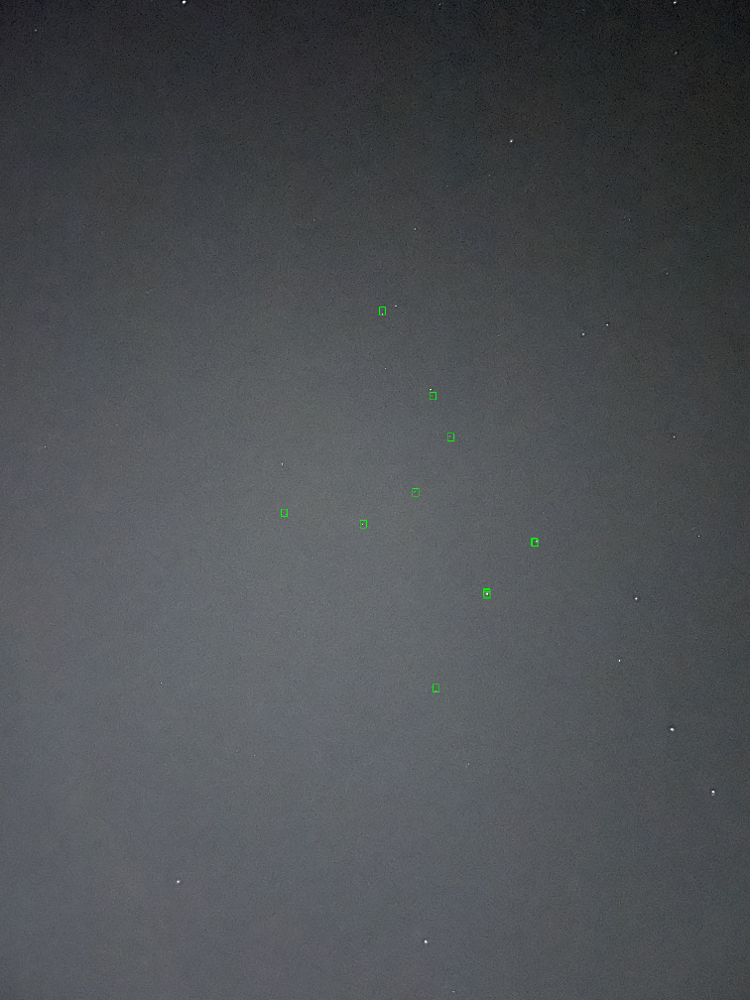

-----Common Stars-----
X: 1143.92236328125, Y: 2067.62255859375, Size: 1.0, Response: 0.0
X: 1143.92236328125, Y: 2067.62255859375, Size: 1.0, Response: 0.0
X: 1143.92236328125, Y: 2067.62255859375, Size: 1.0, Response: 0.0
X: 1462.1644287109375, Y: 2113.41259765625, Size: 1.0, Response: 0.0
X: 1462.1644287109375, Y: 2113.41259765625, Size: 1.0, Response: 0.0
X: 1539.2288818359375, Y: 1253.3363037109375, Size: 1.0, Response: 0.0
X: 1673.873291015625, Y: 1985.8780517578125, Size: 1.0, Response: 0.0
X: 1673.873291015625, Y: 1985.8780517578125, Size: 1.0, Response: 0.0
X: 1756.657958984375, Y: 2774.114990234375, Size: 1.0, Response: 0.0
X: 1756.657958984375, Y: 2774.114990234375, Size: 1.0, Response: 0.0
X: 1756.657958984375, Y: 2774.114990234375, Size: 1.0, Response: 0.0
X: 1742.90771484375, Y: 1596.1920166015625, Size: 1.0, Response: 0.0
X: 1742.90771484375, Y: 1596.1920166015625, Size: 1.0, Response: 0.0
X: 1742.90771484375, Y: 1596.1920166015625, Size: 1.0, Response: 0.0
X: 1742.90771

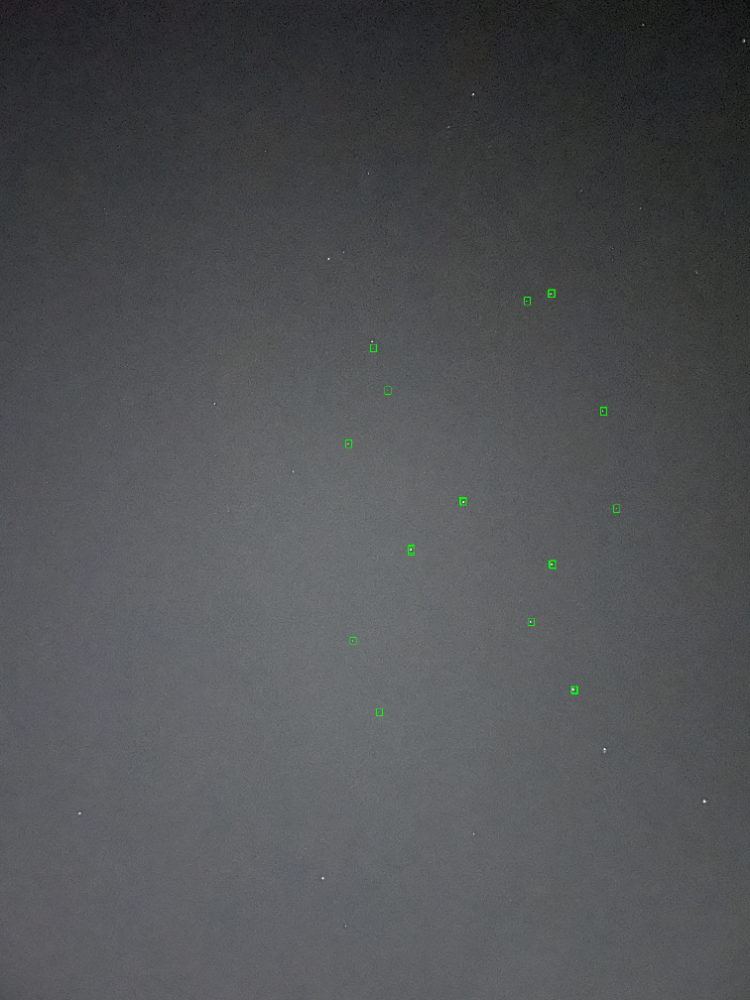

MATCH


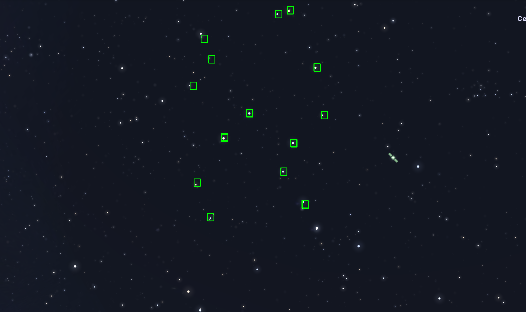

-----Common Stars-----
X: 770.0067138671875, Y: 343.666015625, Size: 1.0, Response: 0.0
X: 770.0067138671875, Y: 343.666015625, Size: 1.0, Response: 0.0
X: 786.4678955078125, Y: 730.1809692382812, Size: 1.0, Response: 0.0
X: 786.4678955078125, Y: 730.1809692382812, Size: 1.0, Response: 0.0
X: 786.4678955078125, Y: 730.1809692382812, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 814.9368896484375, Y: 155.13043212890625, Size: 1.0, Response: 0.0
X: 840.1829223632812, Y: 868.8390502929688, Size: 1.0, Response: 0.0
X: 840.1829223632812, Y: 868.8390502929688, Size: 1.0, Response: 0.0
X: 844.4760131835938, Y: 237.70855712890625, Size: 1.0, Response: 0.0
X: 844.4760131835938, Y: 237.70855712890625, Size: 1.0, Response: 0.0
X: 844.47601

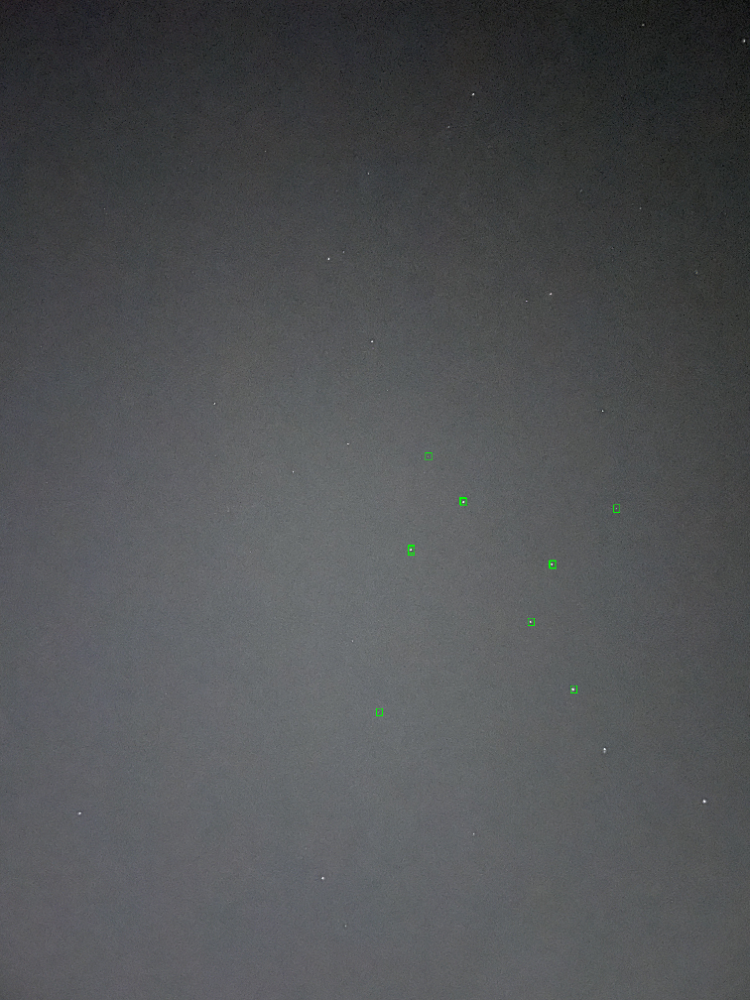

MATCH


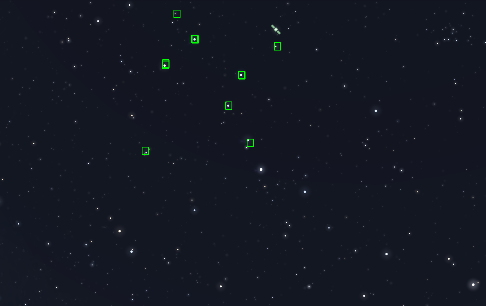

-----Common Stars-----
X: 578.1716918945312, Y: 603.5130615234375, Size: 1.0, Response: 0.0
X: 578.1716918945312, Y: 603.5130615234375, Size: 1.0, Response: 0.0
X: 660.695068359375, Y: 253.847412109375, Size: 1.0, Response: 0.0
X: 660.695068359375, Y: 253.847412109375, Size: 1.0, Response: 0.0
X: 661.0183715820312, Y: 255.6741943359375, Size: 1.0, Response: 0.0
X: 661.0183715820312, Y: 255.6741943359375, Size: 1.0, Response: 0.0
X: 661.0183715820312, Y: 255.6741943359375, Size: 1.0, Response: 0.0
X: 661.0183715820312, Y: 255.6741943359375, Size: 1.0, Response: 0.0
X: 660.9178466796875, Y: 259.5836181640625, Size: 1.0, Response: 0.0
X: 705.6605224609375, Y: 55.8131103515625, Size: 1.0, Response: 0.0
X: 705.6605224609375, Y: 55.8131103515625, Size: 1.0, Response: 0.0
X: 705.6605224609375, Y: 55.8131103515625, Size: 1.0, Response: 0.0
X: 705.6605224609375, Y: 55.8131103515625, Size: 1.0, Response: 0.0
X: 705.6605224609375, Y: 55.8131103515625, Size: 1.0, Response: 0.0
X: 775.9846801757812

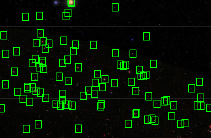

MATCH


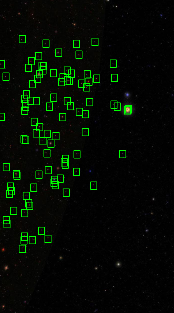

-----Common Stars-----
X: 86.29962158203125, Y: 156.9911651611328, Size: 1.0, Response: 0.0
X: 86.29962158203125, Y: 156.9911651611328, Size: 1.0, Response: 0.0
X: 377.389404296875, Y: 167.04278564453125, Size: 1.0, Response: 0.0
X: 377.389404296875, Y: 167.04278564453125, Size: 1.0, Response: 0.0
X: 377.389404296875, Y: 167.04278564453125, Size: 1.0, Response: 0.0
X: 181.89447021484375, Y: 174.243896484375, Size: 1.0, Response: 0.0
X: 181.89447021484375, Y: 174.243896484375, Size: 1.0, Response: 0.0
X: 303.2572021484375, Y: 175.48641967773438, Size: 1.0, Response: 0.0
X: 303.2572021484375, Y: 175.48641967773438, Size: 1.0, Response: 0.0
X: 303.2572021484375, Y: 175.48641967773438, Size: 1.0, Response: 0.0
X: 303.2572021484375, Y: 175.48641967773438, Size: 1.0, Response: 0.0
X: 303.2572021484375, Y: 175.48641967773438, Size: 1.0, Response: 0.0
X: 232.1143798828125, Y: 210.4208526611328, Size: 1.0, Response: 0.0
X: 232.1143798828125, Y: 210.4208526611328, Size: 1.0, Response: 0.0
X: 232

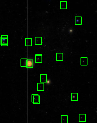

MATCH


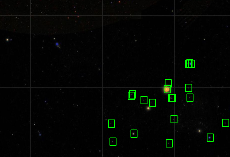

-----Common Stars-----
X: 756.531005859375, Y: 253.67152404785156, Size: 1.0, Response: 0.0
X: 751.53759765625, Y: 255.17088317871094, Size: 1.0, Response: 0.0
X: 751.53759765625, Y: 255.17088317871094, Size: 1.0, Response: 0.0
X: 763.2199096679688, Y: 255.54052734375, Size: 1.0, Response: 0.0
X: 763.2199096679688, Y: 255.54052734375, Size: 1.0, Response: 0.0
X: 763.2199096679688, Y: 255.54052734375, Size: 1.0, Response: 0.0
X: 670.2404174804688, Y: 333.568359375, Size: 1.0, Response: 0.0
X: 752.4466552734375, Y: 351.4262390136719, Size: 1.0, Response: 0.0
X: 752.4466552734375, Y: 351.4262390136719, Size: 1.0, Response: 0.0
X: 666.4451904296875, Y: 356.6939392089844, Size: 1.0, Response: 0.0
X: 666.4451904296875, Y: 356.6939392089844, Size: 1.0, Response: 0.0
X: 666.4451904296875, Y: 356.6939392089844, Size: 1.0, Response: 0.0
X: 666.4451904296875, Y: 356.6939392089844, Size: 1.0, Response: 0.0
X: 666.4451904296875, Y: 356.6939392089844, Size: 1.0, Response: 0.0
X: 527.166259765625, Y:

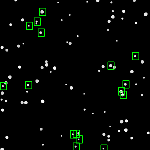

MATCH


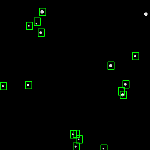

-----Common Stars-----
X: 11.246258735656738, Y: 344.2640686035156, Size: 1.0, Response: 0.0
X: 11.246258735656738, Y: 344.2640686035156, Size: 1.0, Response: 0.0
X: 11.246258735656738, Y: 344.2640686035156, Size: 1.0, Response: 0.0
X: 11.246258735656738, Y: 344.2640686035156, Size: 1.0, Response: 0.0
X: 112.23511505126953, Y: 340.24432373046875, Size: 1.0, Response: 0.0
X: 112.23511505126953, Y: 340.24432373046875, Size: 1.0, Response: 0.0
X: 112.23511505126953, Y: 340.24432373046875, Size: 1.0, Response: 0.0
X: 112.23511505126953, Y: 340.24432373046875, Size: 1.0, Response: 0.0
X: 112.23511505126953, Y: 340.24432373046875, Size: 1.0, Response: 0.0
X: 112.23511505126953, Y: 340.24432373046875, Size: 1.0, Response: 0.0
X: 115.2719955444336, Y: 103.2684097290039, Size: 1.0, Response: 0.0
X: 115.2719955444336, Y: 103.2684097290039, Size: 1.0, Response: 0.0
X: 115.2719955444336, Y: 103.2684097290039, Size: 1.0, Response: 0.0
X: 115.2719955444336, Y: 103.2684097290039, Size: 1.0, Response:

In [11]:
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow
import random

"""
The function receives an image and performs noise filtering and image processing
"""
def load_image(image,flag):
    # Load image
    img = cv2.imread(image, cv2.IMREAD_GRAYSCALE)
    # Apply binary thresholding to convert to black and white
    if flag:
        ret, img = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
    # define structuring element for morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
    # perform morphological opening to remove small spots
    opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
    return opening

"""
The function receives a processed image using the load_image function.
Outputs coordinates of stars in SIFT means.
 Creates patterns of triangles using three stars
"""
def create_triangle(image,sigma,flag):
    img = cv2.imread(image)
    filtered_img = load_image(image,flag)

    #The cv2.SIFT_create() function creates a SIFT object that can be used to detect keypoints
    # and extract descriptors from images using the SIFT algorithm.
    # The sigma parameter sets the scale of the difference of Gaussians used to detect keypoints

    sift = cv2.SIFT_create(sigma=sigma)
    kp = sift.detect(filtered_img, None)
    # sort the stars by response
    kp_filter = sorted(kp, key=lambda x: x.size, reverse=True)

    # Get keypoints coordinates as a NumPy array
    pts = np.array([k.pt for k in kp[:]], dtype=np.float32)

    # Compute Delaunay triangulation of the keypoints
    tri = cv2.Subdiv2D((0, 0, img.shape[1], img.shape[0]))
    tri.insert(pts)
    triangle_list = tri.getTriangleList()
    return triangle_list, kp, img

"""
The function receives a list of triangles
calculates their angles and returns a dictionary.
Key=angles , value=vertices
"""
def angle(triangle_list):
    # Create empty dictionary to store triangles by angles
    triangle_dict = {}
    # Loop through each triangle in the list
    for i in range(triangle_list.shape[0]):
        angle=[]
        # Get vertices of current triangle
        tri_pts = triangle_list[i].reshape(3, 2)

        # Get edges of triangle
        a = np.linalg.norm(tri_pts[0] - tri_pts[1])
        b = np.linalg.norm(tri_pts[1] - tri_pts[2])
        c = np.linalg.norm(tri_pts[2] - tri_pts[0])

        # Calculate angles using law of cosines
        alpha = np.degrees(np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c)))
        beta = np.degrees(np.arccos((c ** 2 + a ** 2 - b ** 2) / (2 * c * a)))
        gamma = np.degrees(np.arccos((a ** 2 + b ** 2 - c ** 2) / (2 * a * b)))
        angle.append(round(alpha,0))
        angle.append(round(beta,0))
        angle.append(round(gamma,0))

        # Add triangle to dictionary using angles as key
        triangle_dict[tuple(angle)] = tri_pts
    return triangle_dict

"""
Get two dictionaries of triangle vertices and its angles
returns the list of similar
"""
def get_shared_angle(map1, map2):
    common_keys = set(map1.keys()) & set(map2.keys())
    shared_vertices = []
    for key in common_keys:
        triangle1 = map1[key]
        triangle2 = map2[key]
        shared_vertices.append((triangle1,triangle2))
    return shared_vertices

"""
 This function takes in two triangles, triangle1 and triangle2, and a set of points points.
 It extracts the (x, y) coordinates from the cv2.KeyPoint objects in points, creates a transformation matrix using cv2.getAffineTransform(),
 applies this transformation matrix to the points using cv2.transform(), converts the transformed points back to cv2.KeyPoint objects,
 and returns these transformed cv2.KeyPoint objects.
"""

def transform_points(triangle1, triangle2, points):
    # Extract (x, y) coordinates from cv2.KeyPoint objects
    points = [(kp.pt[0], kp.pt[1]) for kp in points]

    # Create transformation matrix
    M = cv2.getAffineTransform(triangle1, triangle2)

    # Apply transformation to points
    transformed_points = cv2.transform(np.array([points], dtype='float32'), M)
    transformed_points = transformed_points[0].tolist()

    # Convert back to cv2.KeyPoint objects
    transformed_kps = [cv2.KeyPoint(x, y, 1) for (x, y) in transformed_points]

    return transformed_kps

"""
This function find_shared_keypoints takes two lists of keypoints (keypoints1 and keypoints2)
and a delta_range as input,
and returns a list of keypoints that are close to each other within the specified delta_range
"""
def find_shared_keypoints(keypoints1, keypoints2, delta_range):
    shared_keypoints = []
    for kp1 in keypoints1:
        for kp2 in keypoints2:
            delta = np.sqrt((kp1.pt[0] - kp2.pt[0]) ** 2 + (kp1.pt[1] - kp2.pt[1]) ** 2)
            if delta <= delta_range:
                shared_keypoints.append(kp1)
                break
    return shared_keypoints

"""
The function goes over all similar triangles and performs a transformation.
Returns the transformation that gives the most common starsdef"
"""
def best_tra_transform(similar_triangle, points1,points2,delta):
    transform = []
    original = []
    shared_keypoint = []
    max = 500000
    if(max>len(similar_triangle)):
        max =len(similar_triangle)
    for i in range(max):
        curr_transform =transform_points(similar_triangle[i][0],similar_triangle[i][1],points1)
        curr_shared_keypoints =find_shared_keypoints(curr_transform,points2,delta)
        if len(curr_shared_keypoints) > len(shared_keypoint):
            shared_keypoint = curr_shared_keypoints
            transform = curr_transform
            # find the original shared keypoint from point1 (Reverse transformation)
            curr_original = transform_points(similar_triangle[i][1], similar_triangle[i][0], shared_keypoint)
            curr_shared_original = find_shared_keypoints(curr_original,points1,delta)
            original = curr_shared_original

    return shared_keypoint, transform, original

"""
The draw_keypoints_triangle function takes an image, a triangle, 
and a list of keypoints, and draws the triangle and the keypoints on the image
"""
def draw_keypoints_triangle(image,triangle,keypoints):
    triangle = np.array(triangle)
    # Draw the triangle on the image
    # img_with_keypoints = cv2.drawKeypoints(image, keypoints, None)
    img_combined= cv2.drawContours(image, [triangle.astype(int)], 0, (0, 0, 255), 2)
    image_with_lines_resized = cv2.resize(img_combined, (0, 0), fx=0.30, fy=0.30)

    return image_with_lines_resized

"""
 Display image
"""
def draw_image(image, group_pts):
    # Make a copy of the input image so we don't modify the original
    img = image.copy()

    box_size = 15

    # Draw group points in blue
    for pt in group_pts:
        # cv2.circle(img, (int(pt.pt[0]), int(pt.pt[1])), 3, (255, 0, 0), -1)
        cv2.rectangle(img, (int(pt.pt[0] - 10), int(pt.pt[1] - box_size)),
                      (int(pt.pt[0] + box_size), int(pt.pt[1] + box_size)), (0, 255, 0), 2)
    image_with_lines_resized = cv2.resize(img, (0, 0), fx=0.25, fy=0.25)

    # Save image to "match photo" directory with filename
    match_photo_dir = "match photo"
    os.makedirs(match_photo_dir, exist_ok=True)  # create directory if it doesn't exist
    index = random.randint(1, 100)
    filepath = os.path.join(match_photo_dir, f'{index} match.jpg')
    cv2.imwrite(filepath, image_with_lines_resized)

    return image_with_lines_resized

"""
function that takes a cv2.KeyPoint object and prints its X and Y coordinates, 
as well as the values of its size (size) and response (response) attributes
"""
def print_keypoint_info(keypoints):
   print("-----Common Stars-----")
   for keypoint in keypoints:
        x, y = keypoint.pt
        size = keypoint.size
        response = keypoint.response
        print(f"X: {x}, Y: {y}, Size: {size}, Response: {response}")

"""
get an image and a list of triangles and draws triangles on the image based on those keypoints:
"""
def draw_triangles(image, triangles):
    # Convert image to grayscale

    # Create a copy of the original image to draw on
    img_copy = image.copy()


    # Draw the triangles on the copy of the image
    for triangle in triangles:
        pt1 = (int(triangle[0]), int(triangle[1]))
        pt2 = (int(triangle[2]), int(triangle[3]))
        pt3 = (int(triangle[4]), int(triangle[5]))
        cv2.line(img_copy, pt1, pt2, (0, 0, 255), 1, cv2.LINE_AA)
        cv2.line(img_copy, pt2, pt3, (0, 0, 255), 1, cv2.LINE_AA)
        cv2.line(img_copy, pt3, pt1, (0, 0, 255), 1, cv2.LINE_AA)
    image_with_lines_resized = cv2.resize(img_copy, (0, 0), fx=0.50, fy=0.50)
    cv2.imshow('Match', image_with_lines_resized)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    # Return the copy of the image with the triangles drawn on it
    return image_with_lines_resized

"""

"""
def find_match_stras(image1,image2,sigma,flag):
    triangle_list1 ,kp1 ,img1 = create_triangle(image1,sigma,flag)
    triangle_list2 ,kp2 ,img2 = create_triangle(image2,sigma,flag)
    angle_list1 = angle(triangle_list1)
    angle_list2 = angle(triangle_list2)
    similar_triangle = get_shared_angle(angle_list1,angle_list2)
    shared_keypoints ,transformed_points, original =best_tra_transform(similar_triangle,kp1,kp2,15)
    img3=draw_image(img2,shared_keypoints)
    img4=draw_image(img1,original)
    print("D.B")
    cv2_imshow(img4)
    print("MATCH")
    cv2_imshow(img3)
    print_keypoint_info(shared_keypoints)






sigma = 0.9
flag = 1
find_match_stras('/content/drive/MyDrive/Colab Notebooks/ST_db1.png','/content/drive/MyDrive/Colab Notebooks/ST_db2.png',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/fr2.jpg','/content/drive/MyDrive/Colab Notebooks/fr1.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/ST_db1.png','/content/drive/MyDrive/Colab Notebooks/fr1.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/fr2.jpg','/content/drive/MyDrive/Colab Notebooks/ST_db2.png',sigma,flag)


# add more
find_match_stras('/content/drive/MyDrive/Colab Notebooks/ST_db1.png','/content/drive/MyDrive/Colab Notebooks/ST_db2.png',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/ST_db1.png','/content/drive/MyDrive/Colab Notebooks/fr2.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/ST_db2.png','/content/drive/MyDrive/Colab Notebooks/ST_db1.png',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/ST_db2.png','/content/drive/MyDrive/Colab Notebooks/fr2.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/fr1.jpg','/content/drive/MyDrive/Colab Notebooks/fr2.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/fr2.jpg','/content/drive/MyDrive/Colab Notebooks/fr1.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/fr2.jpg','/content/drive/MyDrive/Colab Notebooks/ST_db2.png',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/fr2.jpg','/content/drive/MyDrive/Colab Notebooks/ST_db1.png',sigma,flag)

sigma = 1.3
flag = 0

find_match_stras('/content/drive/MyDrive/Colab Notebooks/str6.jpg','/content/drive/MyDrive/Colab Notebooks/str7.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/str14.jpg','/content/drive/MyDrive/Colab Notebooks/str15.jpg',sigma,flag)
find_match_stras('/content/drive/MyDrive/Colab Notebooks/image_big_0.jpg','/content/drive/MyDrive/Colab Notebooks/image_small_0.jpg',sigma,flag)



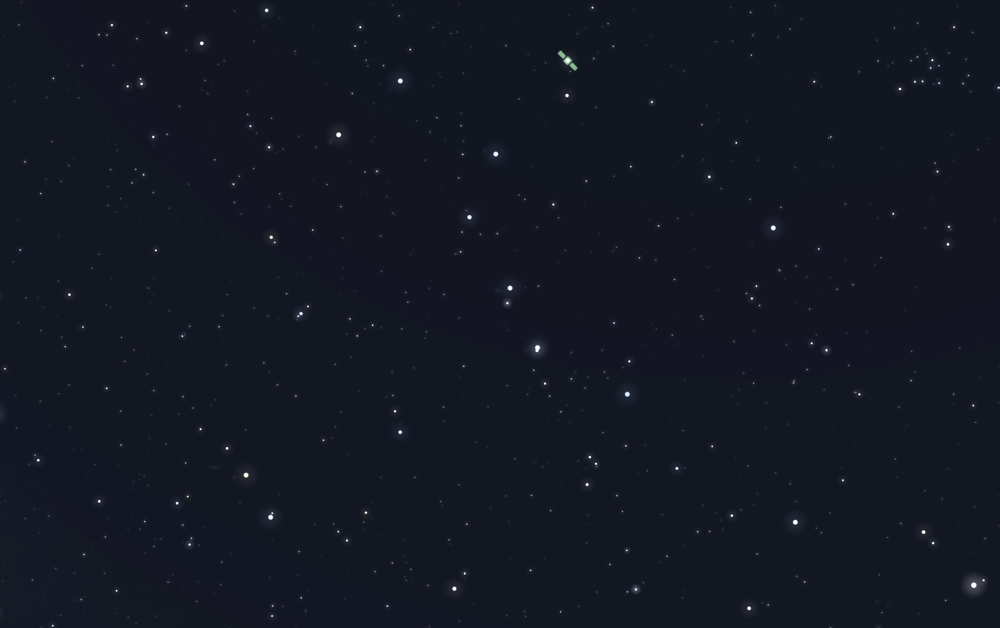

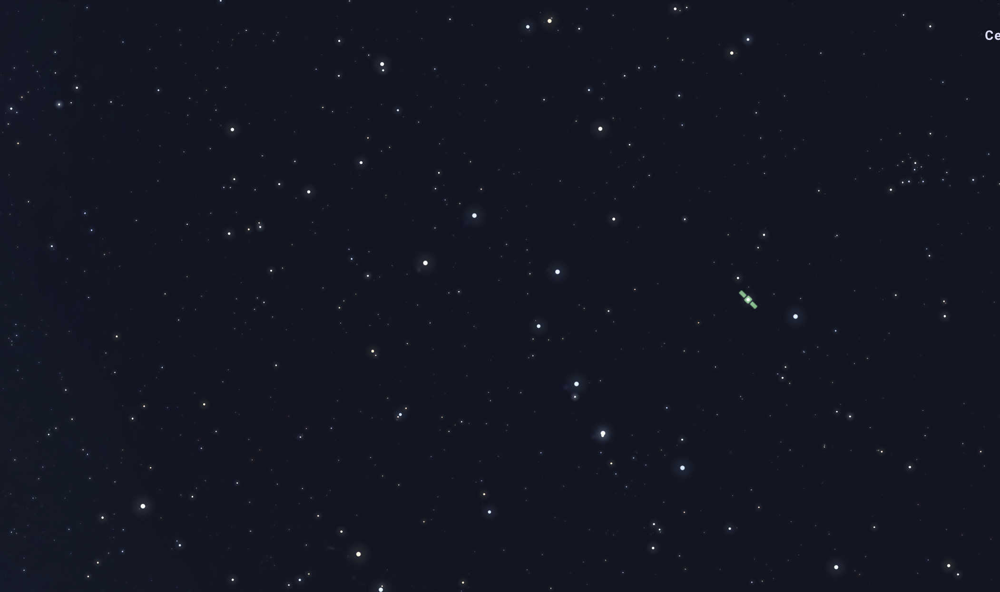



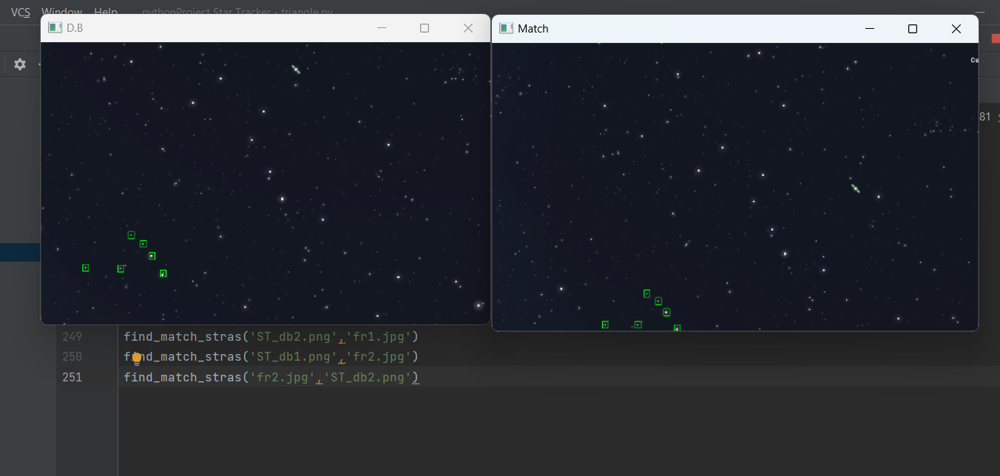

X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 800.3846435546875, Y: 1235.444580078125, Size: 1.0, Response: 0.0


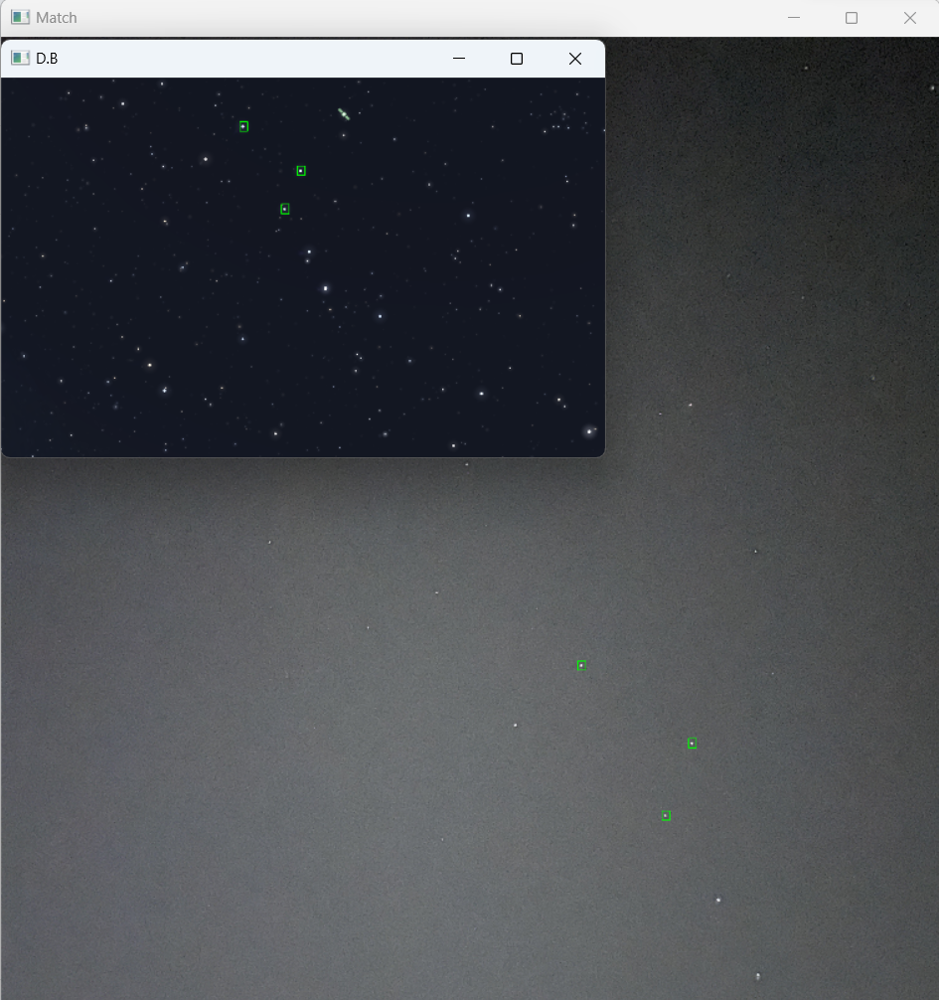

X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 800.3846435546875, Y: 1235.444580078125, Size: 1.0, Response: 0.0
X: 1868.44482421875, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.44482421875, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.44482421875, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0


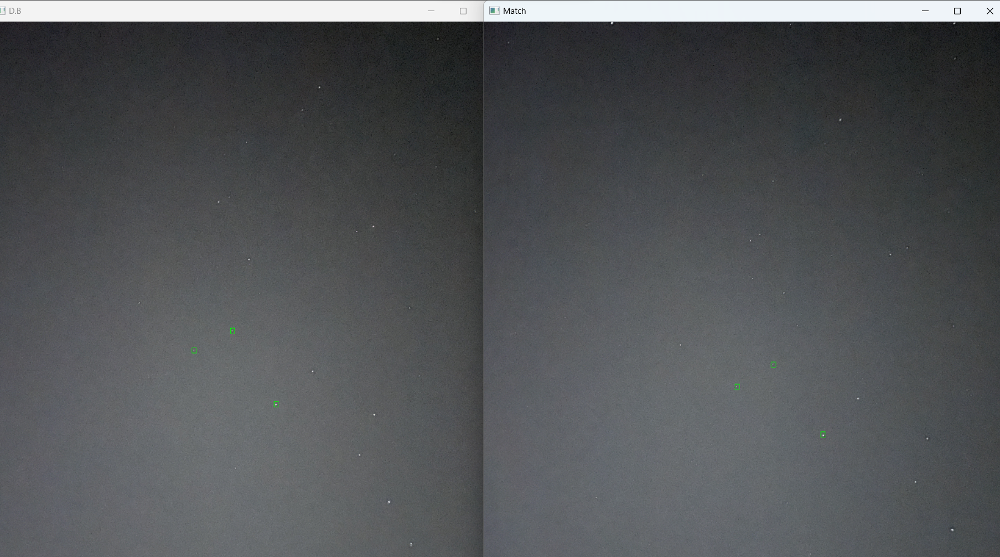

X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 800.3846435546875, Y: 1235.444580078125, Size: 1.0, Response: 0.0


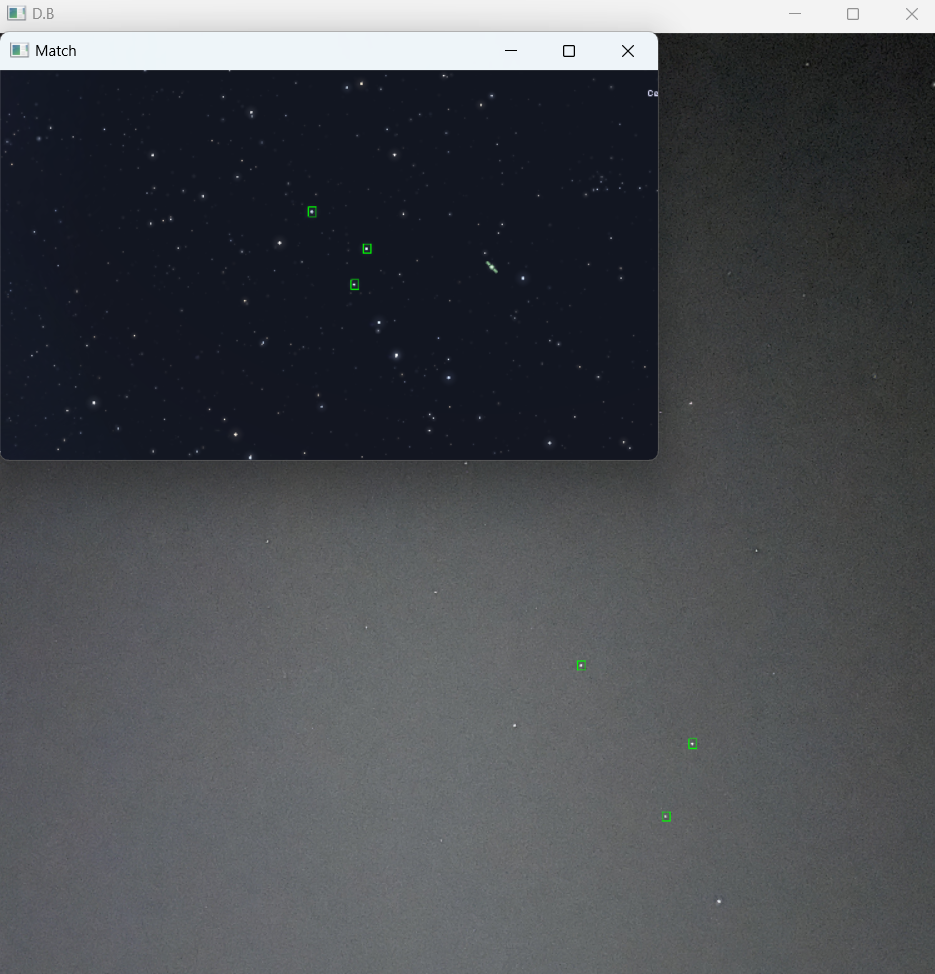

X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 488.8729553222656, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 629.8729248046875, Y: 1220.24609375, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 668.4449462890625, Y: 1085.5721435546875, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 717.321533203125, Y: 1118.988037109375, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 753.0576171875, Y: 1166.131103515625, Size: 1.0, Response: 0.0
X: 800.3846435546875, Y: 1235.444580078125, Size: 1.0, Response: 0.0
X: 1462.16455078125, Y: 2113.41259765625, Size: 1.0, Response: 0.0
X: 1462.16455078125, Y: 2113.41259765625, Size: 1.0, Response: 0.0
X: 1673.873291015625, Y: 1985.8780517578125, Size: 1.0, Response: 0.0
X: 1673.873291015625, Y: 1985.8780517578125, Size: 1.0, Response: 0.0
X: 1960.2376708984375, Y: 2389.995361328125, Size: 1.0, Response: 0.0
X: 1960.2376708984375, Y: 2389.995361328125, Size: 1.0, Response: 0.0
X: 1868.44482421875, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.44482421875, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 1868.44482421875, Y: 2024.1060791015625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2138.58349609375, Y: 2507.845947265625, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 2224.8212890625, Y: 2274.4814453125, Size: 1.0, Response: 0.0
X: 996.9913330078125, Y: 453.439697265625, Size: 1.0, Response: 0.0
X: 996.9913330078125, Y: 453.439697265625, Size: 1.0, Response: 0.0
X: 996.9913330078125, Y: 453.439697265625, Size: 1.0, Response: 0.0
X: 996.9913330078125, Y: 453.439697265625, Size: 1.0, Response: 0.0
X: 996.9913330078125, Y: 453.439697265625, Size: 1.0, Response: 0.0
X: 1132.1619873046875, Y: 686.2402954101562, Size: 1.0, Response: 0.0
X: 1132.1619873046875, Y: 686.2402954101562, Size: 1.0, Response: 0.0
X: 1132.1619873046875, Y: 686.2402954101562, Size: 1.0, Response: 0.0
X: 1171.6129150390625, Y: 571.8837280273438, Size: 1.0, Response: 0.0
X: 1171.6129150390625, Y: 571.8837280273438, Size: 1.0, Response: 0.0
X: 1171.6129150390625, Y: 571.8837280273438, Size: 1.0, Response: 0.0

Process finished with exit code 0


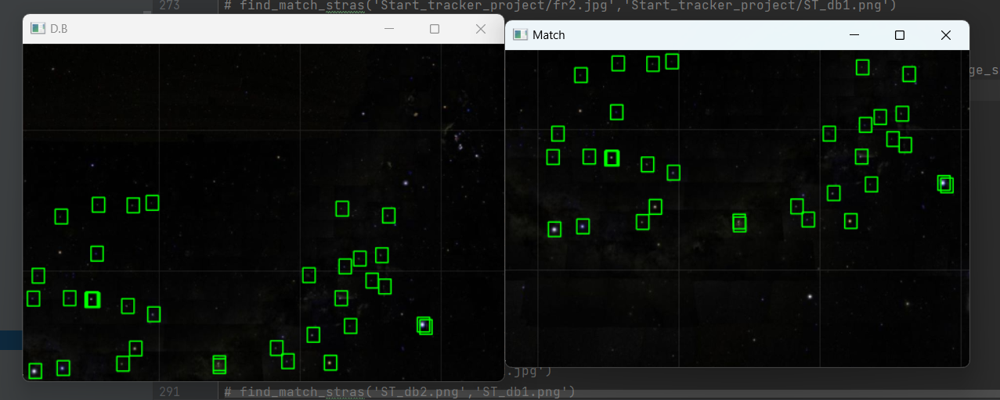

-----Common Points-----

X: 95.27108764648438, Y: 219.11746215820312, Size: 1.0, Response: 0.0
X: 95.27108764648438, Y: 219.11746215820312, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 98.82538604736328, Y: 367.6159362792969, Size: 1.0, Response: 0.0
X: 105.36689758300781, Y: 171.96939086914062, Size: 1.0, Response: 0.0
X: 105.36689758300781, Y: 171.96939086914062, Size: 1.0, Response: 0.0
X: 105.36689758300781, Y: 171.96939086914062, Size: 1.0, Response: 0.0
X: 105.36689758300781, Y: 171.96939086914062, Size: 1.0, Response: 0.0
X: 152.07273864746094, Y: 51.38323974609375, Size: 1.0, Response: 0.0
X: 152.07273864746094, Y: 51.38323974609375, Size: 1.0, Response: 0.0
X: 152.07273864746094, Y: 51.38323974609375, Size: 1.0, Response: 0.0
X: 156.3571319580078, Y: 361.5154724121094, Size: 1.0, Response: 0.0
X: 156.3571319580078, Y: 361.5154724121094, Size: 1.0, Response: 0.0
X: 156.3571319580078, Y: 361.5154724121094, Size: 1.0, Response: 0.0
X: 169.5064697265625, Y: 218.27987670898438, Size: 1.0, Response: 0.0
X: 213.51531982421875, Y: 222.12448120117188, Size: 1.0, Response: 0.0
X: 215.7188720703125, Y: 220.06784057617188, Size: 1.0, Response: 0.0
X: 215.7188720703125, Y: 220.06784057617188, Size: 1.0, Response: 0.0
X: 215.7188720703125, Y: 220.06784057617188, Size: 1.0, Response: 0.0
X: 215.7188720703125, Y: 220.06784057617188, Size: 1.0, Response: 0.0
X: 215.7188720703125, Y: 220.06784057617188, Size: 1.0, Response: 0.0
X: 217.99789428710938, Y: 222.52084350585938, Size: 1.0, Response: 0.0
X: 225.34024047851562, Y: 127.16571044921875, Size: 1.0, Response: 0.0
X: 225.34024047851562, Y: 127.16571044921875, Size: 1.0, Response: 0.0
X: 225.34024047851562, Y: 127.16571044921875, Size: 1.0, Response: 0.0
X: 225.34024047851562, Y: 127.16571044921875, Size: 1.0, Response: 0.0
X: 228.33621215820312, Y: 27.114959716796875, Size: 1.0, Response: 0.0
X: 278.33563232421875, Y: 352.8030090332031, Size: 1.0, Response: 0.0
X: 278.33563232421875, Y: 352.8030090332031, Size: 1.0, Response: 0.0
X: 278.33563232421875, Y: 352.8030090332031, Size: 1.0, Response: 0.0
X: 278.33563232421875, Y: 352.8030090332031, Size: 1.0, Response: 0.0
X: 278.33563232421875, Y: 352.8030090332031, Size: 1.0, Response: 0.0
X: 288.3324890136719, Y: 234.19320678710938, Size: 1.0, Response: 0.0
X: 299.78216552734375, Y: 28.51220703125, Size: 1.0, Response: 0.0
X: 304.861083984375, Y: 321.3661804199219, Size: 1.0, Response: 0.0
X: 304.861083984375, Y: 321.3661804199219, Size: 1.0, Response: 0.0
X: 338.4699401855469, Y: 23.452392578125, Size: 1.0, Response: 0.0
X: 338.4699401855469, Y: 23.452392578125, Size: 1.0, Response: 0.0
X: 338.4699401855469, Y: 23.452392578125, Size: 1.0, Response: 0.0
X: 341.4503173828125, Y: 251.53530883789062, Size: 1.0, Response: 0.0
X: 341.4503173828125, Y: 251.53530883789062, Size: 1.0, Response: 0.0
X: 475.8462219238281, Y: 351.8554382324219, Size: 1.0, Response: 0.0
X: 476.4206848144531, Y: 357.5021667480469, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 593.311279296875, Y: 320.3824768066406, Size: 1.0, Response: 0.0
X: 616.1056518554688, Y: 347.5351867675781, Size: 1.0, Response: 0.0
X: 659.2176513671875, Y: 171.32308959960938, Size: 1.0, Response: 0.0
X: 659.2176513671875, Y: 171.32308959960938, Size: 1.0, Response: 0.0
X: 659.2176513671875, Y: 171.32308959960938, Size: 1.0, Response: 0.0
X: 668.0787353515625, Y: 293.9439392089844, Size: 1.0, Response: 0.0
X: 668.0787353515625, Y: 293.9439392089844, Size: 1.0, Response: 0.0
X: 668.0787353515625, Y: 293.9439392089844, Size: 1.0, Response: 0.0
X: 668.0787353515625, Y: 293.9439392089844, Size: 1.0, Response: 0.0
X: 703.615478515625, Y: 350.6109924316406, Size: 1.0, Response: 0.0
X: 703.615478515625, Y: 350.6109924316406, Size: 1.0, Response: 0.0
X: 725.1987915039062, Y: 218.37222290039062, Size: 1.0, Response: 0.0
X: 727.3062133789062, Y: 35.2335205078125, Size: 1.0, Response: 0.0
X: 733.873779296875, Y: 153.952392578125, Size: 1.0, Response: 0.0
X: 733.873779296875, Y: 153.952392578125, Size: 1.0, Response: 0.0
X: 733.873779296875, Y: 153.952392578125, Size: 1.0, Response: 0.0
X: 745.0989990234375, Y: 275.5482482910156, Size: 1.0, Response: 0.0
X: 745.0989990234375, Y: 275.5482482910156, Size: 1.0, Response: 0.0
X: 745.0989990234375, Y: 275.5482482910156, Size: 1.0, Response: 0.0
X: 745.0989990234375, Y: 275.5482482910156, Size: 1.0, Response: 0.0
X: 763.2272338867188, Y: 137.45358276367188, Size: 1.0, Response: 0.0
X: 763.2272338867188, Y: 137.45358276367188, Size: 1.0, Response: 0.0
X: 763.2272338867188, Y: 137.45358276367188, Size: 1.0, Response: 0.0
X: 789.0814208984375, Y: 182.18194580078125, Size: 1.0, Response: 0.0
X: 789.0814208984375, Y: 182.18194580078125, Size: 1.0, Response: 0.0
X: 789.0814208984375, Y: 182.18194580078125, Size: 1.0, Response: 0.0
X: 808.481201171875, Y: 130.44046020507812, Size: 1.0, Response: 0.0
X: 814.5995483398438, Y: 194.18099975585938, Size: 1.0, Response: 0.0
X: 814.5995483398438, Y: 194.18099975585938, Size: 1.0, Response: 0.0
X: 822.7205200195312, Y: 49.63653564453125, Size: 1.0, Response: 0.0
X: 893.5930786132812, Y: 272.3909606933594, Size: 1.0, Response: 0.0
X: 893.5930786132812, Y: 272.3909606933594, Size: 1.0, Response: 0.0
X: 899.2876586914062, Y: 277.2176208496094, Size: 1.0, Response: 0.0

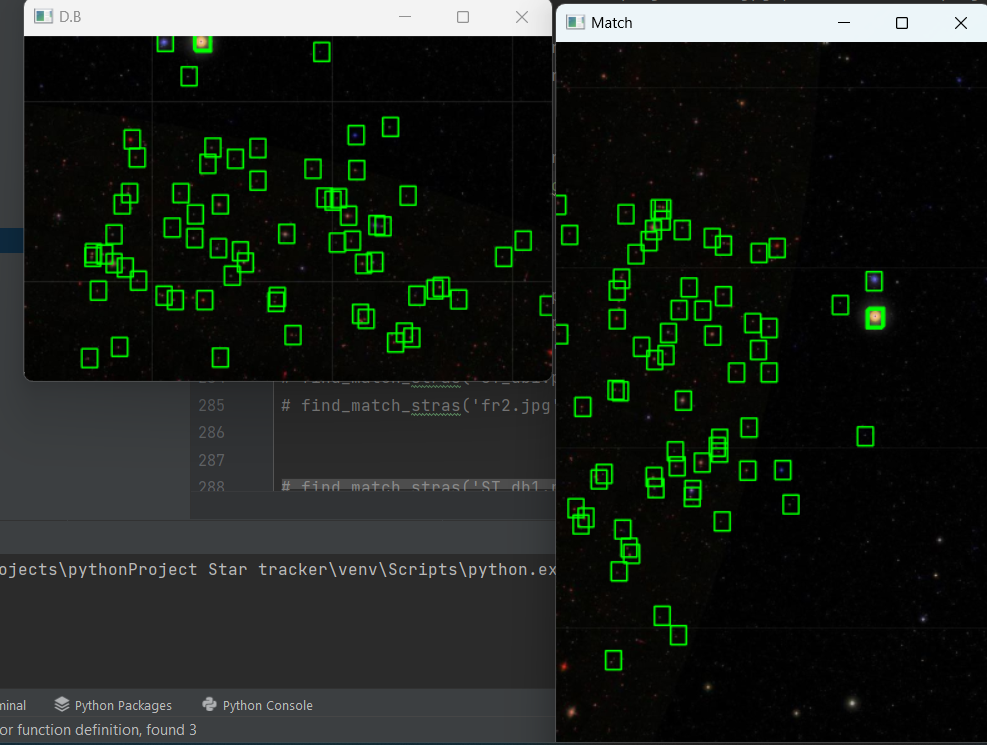

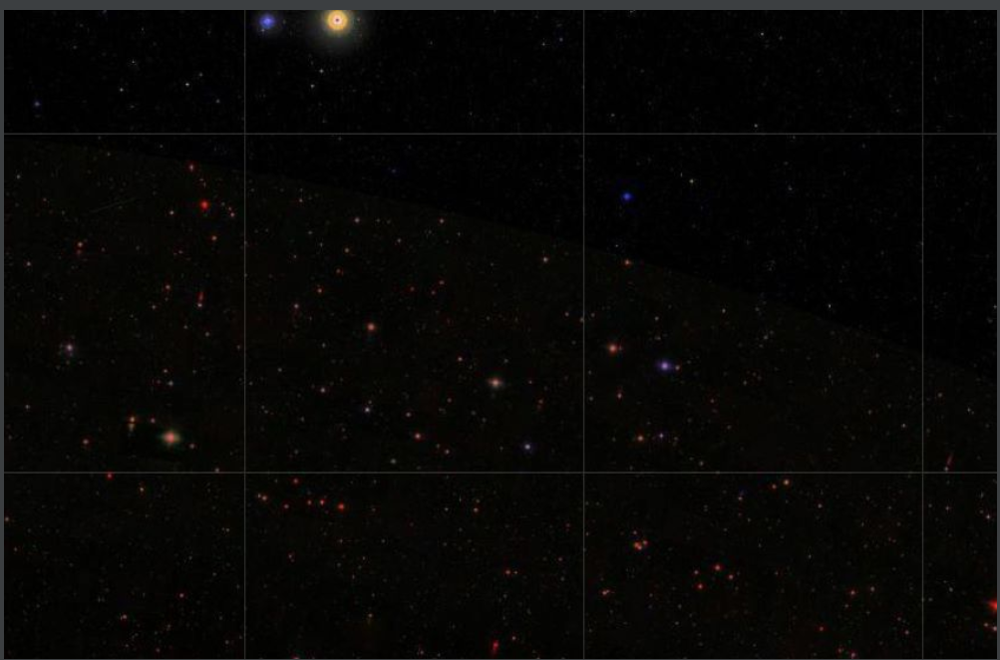


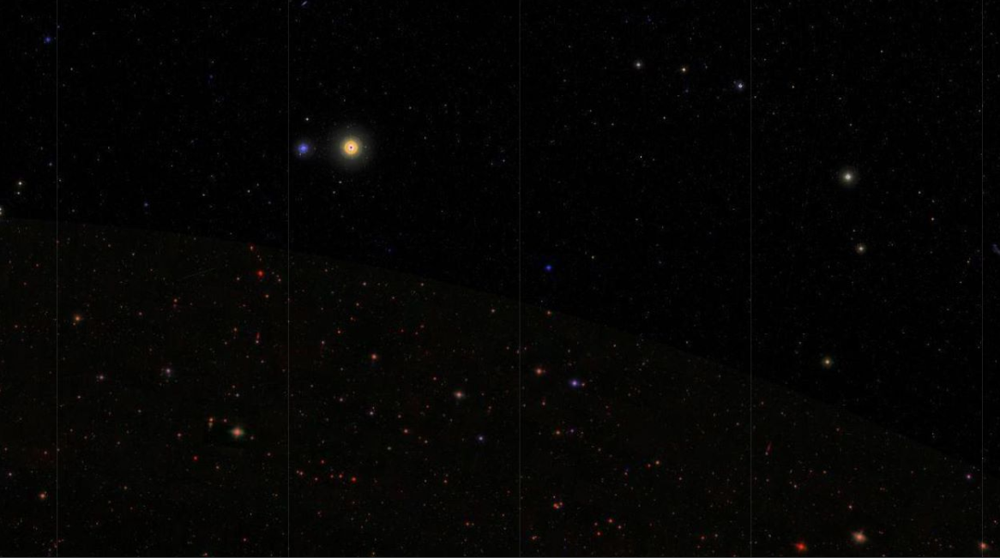

-----Common Points-----

X: 0.80615234375, Y: 260.77496337890625, Size: 1.0, Response: 0.0
X: 0.80615234375, Y: 260.77496337890625, Size: 1.0, Response: 0.0
X: 162.5775146484375, Y: 267.1221618652344, Size: 1.0, Response: 0.0
X: 162.5775146484375, Y: 267.1221618652344, Size: 1.0, Response: 0.0
X: 168.52664184570312, Y: 267.8063049316406, Size: 1.0, Response: 0.0
X: 168.52664184570312, Y: 267.8063049316406, Size: 1.0, Response: 0.0
X: 109.02972412109375, Y: 275.4635314941406, Size: 1.0, Response: 0.0
X: 109.02972412109375, Y: 275.4635314941406, Size: 1.0, Response: 0.0
X: 109.02972412109375, Y: 275.4635314941406, Size: 1.0, Response: 0.0
X: 167.44061279296875, Y: 285.19915771484375, Size: 1.0, Response: 0.0
X: 167.44061279296875, Y: 285.19915771484375, Size: 1.0, Response: 0.0
X: 167.44061279296875, Y: 285.19915771484375, Size: 1.0, Response: 0.0
X: 167.44061279296875, Y: 285.19915771484375, Size: 1.0, Response: 0.0
X: 167.44061279296875, Y: 285.19915771484375, Size: 1.0, Response: 0.0
X: 153.19625854492188, Y: 300.10498046875, Size: 1.0, Response: 0.0
X: 199.31109619140625, Y: 300.2691955566406, Size: 1.0, Response: 0.0
X: 199.31109619140625, Y: 300.2691955566406, Size: 1.0, Response: 0.0
X: 19.257537841796875, Y: 308.78143310546875, Size: 1.0, Response: 0.0
X: 19.257537841796875, Y: 308.78143310546875, Size: 1.0, Response: 0.0
X: 19.257537841796875, Y: 308.78143310546875, Size: 1.0, Response: 0.0
X: 19.257537841796875, Y: 308.78143310546875, Size: 1.0, Response: 0.0
X: 19.257537841796875, Y: 308.78143310546875, Size: 1.0, Response: 0.0
X: 19.257537841796875, Y: 308.78143310546875, Size: 1.0, Response: 0.0
X: 247.34442138671875, Y: 313.22833251953125, Size: 1.0, Response: 0.0
X: 247.34442138671875, Y: 313.22833251953125, Size: 1.0, Response: 0.0
X: 247.34442138671875, Y: 313.22833251953125, Size: 1.0, Response: 0.0
X: 146.0838623046875, Y: 318.0346374511719, Size: 1.0, Response: 0.0
X: 146.0838623046875, Y: 318.0346374511719, Size: 1.0, Response: 0.0
X: 146.0838623046875, Y: 318.0346374511719, Size: 1.0, Response: 0.0
X: 146.0838623046875, Y: 318.0346374511719, Size: 1.0, Response: 0.0
X: 146.0838623046875, Y: 318.0346374511719, Size: 1.0, Response: 0.0
X: 146.0838623046875, Y: 318.0346374511719, Size: 1.0, Response: 0.0
X: 265.530517578125, Y: 325.02642822265625, Size: 1.0, Response: 0.0
X: 265.530517578125, Y: 325.02642822265625, Size: 1.0, Response: 0.0
X: 351.02435302734375, Y: 329.3124694824219, Size: 1.0, Response: 0.0
X: 351.02435302734375, Y: 329.3124694824219, Size: 1.0, Response: 0.0
X: 351.02435302734375, Y: 329.3124694824219, Size: 1.0, Response: 0.0
X: 351.02435302734375, Y: 329.3124694824219, Size: 1.0, Response: 0.0
X: 322.5229797363281, Y: 337.36016845703125, Size: 1.0, Response: 0.0
X: 322.5229797363281, Y: 337.36016845703125, Size: 1.0, Response: 0.0
X: 322.5229797363281, Y: 337.36016845703125, Size: 1.0, Response: 0.0
X: 322.5229797363281, Y: 337.36016845703125, Size: 1.0, Response: 0.0
X: 322.5229797363281, Y: 337.36016845703125, Size: 1.0, Response: 0.0
X: 125.55584716796875, Y: 339.03179931640625, Size: 1.0, Response: 0.0
X: 125.55584716796875, Y: 339.03179931640625, Size: 1.0, Response: 0.0
X: 125.55584716796875, Y: 339.03179931640625, Size: 1.0, Response: 0.0
X: 102.2203369140625, Y: 378.9962158203125, Size: 1.0, Response: 0.0
X: 506.6922302246094, Y: 382.7359313964844, Size: 1.0, Response: 0.0
X: 506.6922302246094, Y: 382.7359313964844, Size: 1.0, Response: 0.0
X: 506.6922302246094, Y: 382.7359313964844, Size: 1.0, Response: 0.0
X: 506.6922302246094, Y: 382.7359313964844, Size: 1.0, Response: 0.0
X: 210.99005126953125, Y: 392.3843078613281, Size: 1.0, Response: 0.0
X: 210.99005126953125, Y: 392.3843078613281, Size: 1.0, Response: 0.0
X: 95.17007446289062, Y: 397.29986572265625, Size: 1.0, Response: 0.0
X: 95.17007446289062, Y: 397.29986572265625, Size: 1.0, Response: 0.0
X: 95.17007446289062, Y: 397.29986572265625, Size: 1.0, Response: 0.0
X: 95.17007446289062, Y: 397.29986572265625, Size: 1.0, Response: 0.0
X: 95.17007446289062, Y: 397.29986572265625, Size: 1.0, Response: 0.0
X: 265.39031982421875, Y: 406.361328125, Size: 1.0, Response: 0.0
X: 265.39031982421875, Y: 406.361328125, Size: 1.0, Response: 0.0
X: 452.52752685546875, Y: 420.3802185058594, Size: 1.0, Response: 0.0
X: 194.16647338867188, Y: 428.16168212890625, Size: 1.0, Response: 0.0
X: 194.16647338867188, Y: 428.16168212890625, Size: 1.0, Response: 0.0
X: 194.16647338867188, Y: 428.16168212890625, Size: 1.0, Response: 0.0
X: 232.25369262695312, Y: 429.234619140625, Size: 1.0, Response: 0.0
X: 510.6659240722656, Y: 439.9624938964844, Size: 1.0, Response: 0.0
X: 508.4303894042969, Y: 441.56793212890625, Size: 1.0, Response: 0.0
X: 508.4303894042969, Y: 441.56793212890625, Size: 1.0, Response: 0.0
X: 508.4303894042969, Y: 441.56793212890625, Size: 1.0, Response: 0.0
X: 506.38323974609375, Y: 443.696533203125, Size: 1.0, Response: 0.0
X: 506.38323974609375, Y: 443.696533203125, Size: 1.0, Response: 0.0
X: 95.43630981445312, Y: 443.521728515625, Size: 1.0, Response: 0.0
X: 312.9915771484375, Y: 449.0643005371094, Size: 1.0, Response: 0.0
X: 338.7266845703125, Y: 457.61328125, Size: 1.0, Response: 0.0
X: 338.7266845703125, Y: 457.61328125, Size: 1.0, Response: 0.0
X: 338.7266845703125, Y: 457.61328125, Size: 1.0, Response: 0.0
X: 177.72616577148438, Y: 465.8394470214844, Size: 1.0, Response: 0.0
X: 177.72616577148438, Y: 465.8394470214844, Size: 1.0, Response: 0.0
X: 177.72616577148438, Y: 465.8394470214844, Size: 1.0, Response: 0.0
X: 3.0806884765625, Y: 467.9311828613281, Size: 1.0, Response: 0.0
X: 3.0806884765625, Y: 467.9311828613281, Size: 1.0, Response: 0.0
X: 248.1015625, Y: 469.1732177734375, Size: 1.0, Response: 0.0
X: 248.1015625, Y: 469.1732177734375, Size: 1.0, Response: 0.0
X: 134.214599609375, Y: 487.522216796875, Size: 1.0, Response: 0.0
X: 321.4413757324219, Y: 492.9521484375, Size: 1.0, Response: 0.0
X: 321.4413757324219, Y: 492.9521484375, Size: 1.0, Response: 0.0
X: 321.4413757324219, Y: 492.9521484375, Size: 1.0, Response: 0.0
X: 321.4413757324219, Y: 492.9521484375, Size: 1.0, Response: 0.0
X: 321.4413757324219, Y: 492.9521484375, Size: 1.0, Response: 0.0
X: 321.4413757324219, Y: 492.9521484375, Size: 1.0, Response: 0.0
X: 173.68106079101562, Y: 500.39764404296875, Size: 1.0, Response: 0.0
X: 173.68106079101562, Y: 500.39764404296875, Size: 1.0, Response: 0.0
X: 155.71090698242188, Y: 508.2141418457031, Size: 1.0, Response: 0.0
X: 155.71090698242188, Y: 508.2141418457031, Size: 1.0, Response: 0.0
X: 155.71090698242188, Y: 508.2141418457031, Size: 1.0, Response: 0.0
X: 155.71090698242188, Y: 508.2141418457031, Size: 1.0, Response: 0.0
X: 155.71090698242188, Y: 508.2141418457031, Size: 1.0, Response: 0.0
X: 155.71090698242188, Y: 508.2141418457031, Size: 1.0, Response: 0.0
X: 338.386474609375, Y: 528.7667236328125, Size: 1.0, Response: 0.0
X: 286.3282165527344, Y: 528.7242431640625, Size: 1.0, Response: 0.0
X: 286.3282165527344, Y: 528.7242431640625, Size: 1.0, Response: 0.0
X: 93.1048583984375, Y: 556.7568359375, Size: 1.0, Response: 0.0
X: 93.1048583984375, Y: 556.7568359375, Size: 1.0, Response: 0.0
X: 100.94461059570312, Y: 558.6730346679688, Size: 1.0, Response: 0.0
X: 201.24716186523438, Y: 573.782470703125, Size: 1.0, Response: 0.0
X: 201.24716186523438, Y: 573.782470703125, Size: 1.0, Response: 0.0
X: 201.24716186523438, Y: 573.782470703125, Size: 1.0, Response: 0.0
X: 40.423980712890625, Y: 583.779296875, Size: 1.0, Response: 0.0
X: 40.423980712890625, Y: 583.779296875, Size: 1.0, Response: 0.0
X: 40.423980712890625, Y: 583.779296875, Size: 1.0, Response: 0.0
X: 40.423980712890625, Y: 583.779296875, Size: 1.0, Response: 0.0
X: 40.423980712890625, Y: 583.779296875, Size: 1.0, Response: 0.0
X: 40.423980712890625, Y: 583.779296875, Size: 1.0, Response: 0.0
X: 306.09295654296875, Y: 616.15771484375, Size: 1.0, Response: 0.0
X: 306.09295654296875, Y: 616.15771484375, Size: 1.0, Response: 0.0
X: 492.87982177734375, Y: 630.2758178710938, Size: 1.0, Response: 0.0
X: 492.87982177734375, Y: 630.2758178710938, Size: 1.0, Response: 0.0
X: 259.86505126953125, Y: 634.2392578125, Size: 1.0, Response: 0.0
X: 259.86505126953125, Y: 634.2392578125, Size: 1.0, Response: 0.0
X: 259.86505126953125, Y: 634.2392578125, Size: 1.0, Response: 0.0
X: 255.3480224609375, Y: 647.0905151367188, Size: 1.0, Response: 0.0
X: 188.45123291015625, Y: 654.1744384765625, Size: 1.0, Response: 0.0
X: 259.37213134765625, Y: 656.1502685546875, Size: 1.0, Response: 0.0
X: 259.37213134765625, Y: 656.1502685546875, Size: 1.0, Response: 0.0
X: 231.17138671875, Y: 672.6446533203125, Size: 1.0, Response: 0.0
X: 231.17138671875, Y: 672.6446533203125, Size: 1.0, Response: 0.0
X: 231.17138671875, Y: 672.6446533203125, Size: 1.0, Response: 0.0
X: 231.17138671875, Y: 672.6446533203125, Size: 1.0, Response: 0.0
X: 231.17138671875, Y: 672.6446533203125, Size: 1.0, Response: 0.0
X: 191.128173828125, Y: 678.13037109375, Size: 1.0, Response: 0.0
X: 191.128173828125, Y: 678.13037109375, Size: 1.0, Response: 0.0
X: 191.128173828125, Y: 678.13037109375, Size: 1.0, Response: 0.0
X: 360.10302734375, Y: 684.9518432617188, Size: 1.0, Response: 0.0
X: 360.10302734375, Y: 684.9518432617188, Size: 1.0, Response: 0.0
X: 304.58050537109375, Y: 685.103515625, Size: 1.0, Response: 0.0
X: 304.58050537109375, Y: 685.103515625, Size: 1.0, Response: 0.0
X: 74.89849853515625, Y: 690.7435913085938, Size: 1.0, Response: 0.0
X: 154.93304443359375, Y: 695.7345581054688, Size: 1.0, Response: 0.0
X: 154.93304443359375, Y: 695.7345581054688, Size: 1.0, Response: 0.0
X: 154.93304443359375, Y: 695.7345581054688, Size: 1.0, Response: 0.0
X: 66.38177490234375, Y: 699.4117431640625, Size: 1.0, Response: 0.0
X: 66.38177490234375, Y: 699.4117431640625, Size: 1.0, Response: 0.0
X: 157.23477172851562, Y: 713.3641967773438, Size: 1.0, Response: 0.0
X: 157.23477172851562, Y: 713.3641967773438, Size: 1.0, Response: 0.0
X: 157.23477172851562, Y: 713.3641967773438, Size: 1.0, Response: 0.0
X: 157.23477172851562, Y: 713.3641967773438, Size: 1.0, Response: 0.0
X: 216.474365234375, Y: 716.40673828125, Size: 1.0, Response: 0.0
X: 216.474365234375, Y: 716.40673828125, Size: 1.0, Response: 0.0
X: 215.07217407226562, Y: 727.1498413085938, Size: 1.0, Response: 0.0
X: 215.07217407226562, Y: 727.1498413085938, Size: 1.0, Response: 0.0
X: 215.07217407226562, Y: 727.1498413085938, Size: 1.0, Response: 0.0
X: 373.45892333984375, Y: 739.4243774414062, Size: 1.0, Response: 0.0
X: 373.45892333984375, Y: 739.4243774414062, Size: 1.0, Response: 0.0
X: 373.45892333984375, Y: 739.4243774414062, Size: 1.0, Response: 0.0
X: 373.45892333984375, Y: 739.4243774414062, Size: 1.0, Response: 0.0
X: 373.45892333984375, Y: 739.4243774414062, Size: 1.0, Response: 0.0
X: 29.448394775390625, Y: 745.7120361328125, Size: 1.0, Response: 0.0
X: 29.448394775390625, Y: 745.7120361328125, Size: 1.0, Response: 0.0
X: 45.4808349609375, Y: 760.3284301757812, Size: 1.0, Response: 0.0
X: 45.4808349609375, Y: 760.3284301757812, Size: 1.0, Response: 0.0
X: 45.4808349609375, Y: 760.3284301757812, Size: 1.0, Response: 0.0
X: 45.4808349609375, Y: 760.3284301757812, Size: 1.0, Response: 0.0
X: 45.4808349609375, Y: 760.3284301757812, Size: 1.0, Response: 0.0
X: 45.4808349609375, Y: 760.3284301757812, Size: 1.0, Response: 0.0
X: 263.73388671875, Y: 766.2869262695312, Size: 1.0, Response: 0.0
X: 263.73388671875, Y: 766.2869262695312, Size: 1.0, Response: 0.0
X: 263.73388671875, Y: 766.2869262695312, Size: 1.0, Response: 0.0
X: 263.73388671875, Y: 766.2869262695312, Size: 1.0, Response: 0.0
X: 37.57672119140625, Y: 771.5365600585938, Size: 1.0, Response: 0.0
X: 104.30325317382812, Y: 779.5808715820312, Size: 1.0, Response: 0.0
X: 104.30325317382812, Y: 779.5808715820312, Size: 1.0, Response: 0.0
X: 104.30325317382812, Y: 779.5808715820312, Size: 1.0, Response: 0.0
X: 114.614990234375, Y: 808.3010864257812, Size: 1.0, Response: 0.0
X: 114.614990234375, Y: 808.3010864257812, Size: 1.0, Response: 0.0
X: 114.614990234375, Y: 808.3010864257812, Size: 1.0, Response: 0.0
X: 114.614990234375, Y: 808.3010864257812, Size: 1.0, Response: 0.0
X: 118.32965087890625, Y: 818.3328247070312, Size: 1.0, Response: 0.0
X: 118.32965087890625, Y: 818.3328247070312, Size: 1.0, Response: 0.0
X: 98.54281616210938, Y: 846.7015380859375, Size: 1.0, Response: 0.0
X: 98.54281616210938, Y: 846.7015380859375, Size: 1.0, Response: 0.0
X: 98.54281616210938, Y: 846.7015380859375, Size: 1.0, Response: 0.0
X: 98.54281616210938, Y: 846.7015380859375, Size: 1.0, Response: 0.0
X: 167.0982666015625, Y: 917.457275390625, Size: 1.0, Response: 0.0
X: 167.0982666015625, Y: 917.457275390625, Size: 1.0, Response: 0.0
X: 167.0982666015625, Y: 917.457275390625, Size: 1.0, Response: 0.0
X: 193.1766357421875, Y: 948.2542114257812, Size: 1.0, Response: 0.0
X: 193.1766357421875, Y: 948.2542114257812, Size: 1.0, Response: 0.0
X: 193.1766357421875, Y: 948.2542114257812, Size: 1.0, Response: 0.0
X: 89.76348876953125, Y: 988.260498046875, Size: 1.0, Response: 0.0
X: 89.76348876953125, Y: 988.260498046875, Size: 1.0, Response: 0.0
X: 89.76348876953125, Y: 988.260498046875, Size: 1.0, Response: 0.0

Process finished with exit code 0


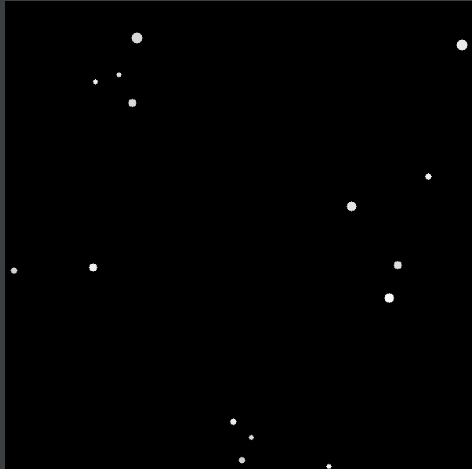

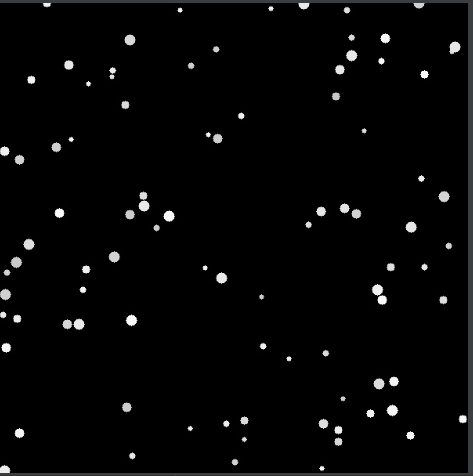

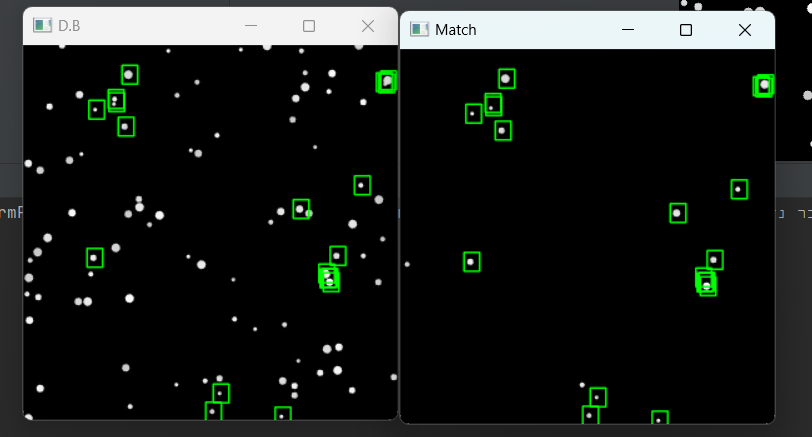


-----Common Points-----

X: 112.24397277832031, Y: 340.25372314453125, Size: 1.0, Response: 0.0
X: 112.24397277832031, Y: 340.25372314453125, Size: 1.0, Response: 0.0
X: 112.24397277832031, Y: 340.25372314453125, Size: 1.0, Response: 0.0
X: 112.24397277832031, Y: 340.25372314453125, Size: 1.0, Response: 0.0
X: 112.24397277832031, Y: 340.25372314453125, Size: 1.0, Response: 0.0
X: 112.24397277832031, Y: 340.25372314453125, Size: 1.0, Response: 0.0
X: 115.25030517578125, Y: 103.24712371826172, Size: 1.0, Response: 0.0
X: 115.25030517578125, Y: 103.24712371826172, Size: 1.0, Response: 0.0
X: 115.25030517578125, Y: 103.24712371826172, Size: 1.0, Response: 0.0
X: 115.25030517578125, Y: 103.24712371826172, Size: 1.0, Response: 0.0
X: 146.33489990234375, Y: 86.03473663330078, Size: 1.0, Response: 0.0
X: 146.33489990234375, Y: 86.03473663330078, Size: 1.0, Response: 0.0
X: 147.4808349609375, Y: 91.24191284179688, Size: 1.0, Response: 0.0
X: 162.2486572265625, Y: 130.2436981201172, Size: 1.0, Response: 0.0
X: 162.2486572265625, Y: 130.2436981201172, Size: 1.0, Response: 0.0
X: 162.2486572265625, Y: 130.2436981201172, Size: 1.0, Response: 0.0
X: 162.2486572265625, Y: 130.2436981201172, Size: 1.0, Response: 0.0
X: 162.2486572265625, Y: 130.2436981201172, Size: 1.0, Response: 0.0
X: 162.2486572265625, Y: 130.2436981201172, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 168.2432861328125, Y: 47.25376510620117, Size: 1.0, Response: 0.0
X: 302.2557067871094, Y: 586.249755859375, Size: 1.0, Response: 0.0
X: 302.2557067871094, Y: 586.249755859375, Size: 1.0, Response: 0.0
X: 302.2557067871094, Y: 586.249755859375, Size: 1.0, Response: 0.0
X: 302.2557067871094, Y: 586.249755859375, Size: 1.0, Response: 0.0
X: 302.2557067871094, Y: 586.249755859375, Size: 1.0, Response: 0.0
X: 314.2408447265625, Y: 557.24072265625, Size: 1.0, Response: 0.0
X: 314.2408447265625, Y: 557.24072265625, Size: 1.0, Response: 0.0
X: 314.2408447265625, Y: 557.24072265625, Size: 1.0, Response: 0.0
X: 314.2408447265625, Y: 557.24072265625, Size: 1.0, Response: 0.0
X: 314.2408447265625, Y: 557.24072265625, Size: 1.0, Response: 0.0
X: 314.2408447265625, Y: 557.24072265625, Size: 1.0, Response: 0.0
X: 413.2445373535156, Y: 594.218505859375, Size: 1.0, Response: 0.0
X: 413.2445373535156, Y: 594.218505859375, Size: 1.0, Response: 0.0
X: 413.2445373535156, Y: 594.218505859375, Size: 1.0, Response: 0.0
X: 413.2445373535156, Y: 594.218505859375, Size: 1.0, Response: 0.0
X: 413.2445373535156, Y: 594.218505859375, Size: 1.0, Response: 0.0
X: 413.2445373535156, Y: 594.218505859375, Size: 1.0, Response: 0.0
X: 442.02886962890625, Y: 262.1793518066406, Size: 1.0, Response: 0.0
X: 442.02886962890625, Y: 262.1793518066406, Size: 1.0, Response: 0.0
X: 442.02886962890625, Y: 262.1793518066406, Size: 1.0, Response: 0.0
X: 442.02886962890625, Y: 262.1793518066406, Size: 1.0, Response: 0.0
X: 442.02886962890625, Y: 262.1793518066406, Size: 1.0, Response: 0.0
X: 442.02886962890625, Y: 262.1793518066406, Size: 1.0, Response: 0.0
X: 483.9786682128906, Y: 365.7196044921875, Size: 1.0, Response: 0.0
X: 483.9786682128906, Y: 365.7196044921875, Size: 1.0, Response: 0.0
X: 485.9471740722656, Y: 373.6595764160156, Size: 1.0, Response: 0.0
X: 485.9471740722656, Y: 373.6595764160156, Size: 1.0, Response: 0.0
X: 488.56219482421875, Y: 372.852783203125, Size: 1.0, Response: 0.0
X: 488.56219482421875, Y: 372.852783203125, Size: 1.0, Response: 0.0
X: 490.5126953125, Y: 379.7622985839844, Size: 1.0, Response: 0.0
X: 490.5126953125, Y: 379.7622985839844, Size: 1.0, Response: 0.0
X: 501.1988830566406, Y: 337.19439697265625, Size: 1.0, Response: 0.0
X: 501.1988830566406, Y: 337.19439697265625, Size: 1.0, Response: 0.0
X: 540.252197265625, Y: 224.2386016845703, Size: 1.0, Response: 0.0
X: 540.252197265625, Y: 224.2386016845703, Size: 1.0, Response: 0.0
X: 540.252197265625, Y: 224.2386016845703, Size: 1.0, Response: 0.0
X: 540.252197265625, Y: 224.2386016845703, Size: 1.0, Response: 0.0
X: 540.252197265625, Y: 224.2386016845703, Size: 1.0, Response: 0.0
X: 575.1825561523438, Y: 59.16915512084961, Size: 1.0, Response: 0.0
X: 579.430419921875, Y: 61.54391860961914, Size: 1.0, Response: 0.0
X: 579.430419921875, Y: 61.54391860961914, Size: 1.0, Response: 0.0
X: 582.9824829101562, Y: 56.69371032714844, Size: 1.0, Response: 0.0

Process finished with exit code 0
